# 0.0 IMPORTAÇÃO DE BIBLIOTECAS

In [131]:
# !pip install boruta==0.3

In [132]:
# importanto as bibliotecas necessárias
import math
import pandas as pd
import numpy as np
import seaborn as sns
import warnings
import matplotlib.pyplot as plt
import plotly.express as px
from sklearn import preprocessing as pp
from sklearn.ensemble import RandomForestRegressor
from sklearn.linear_model  import LinearRegression
from sklearn.tree import DecisionTreeRegressor
from boruta import BorutaPy
from sklearn.metrics import mean_absolute_error, mean_squared_error, mean_absolute_percentage_error
import plotly.graph_objects as go
warnings.filterwarnings('ignore')

## 0.1 FUNÇÕES AUXILIARES

In [133]:
# chamada em qualquer parte do notebook para aplicar as configurações
def jupyter_settings():
    # Configura o matplotlib para exibir gráficos inline no Jupyter Notebook
    %matplotlib inline
    
    # Define o estilo dos gráficos como 'bmh'
    plt.style.use('bmh')
    # Define o tamanho padrão das figuras
    plt.rcParams['figure.figsize'] = [25, 12]
    # Define o tamanho da fonte padrão
    plt.rcParams['font.size'] = 24
    
    # Configurações opcionais para exibição de dados no pandas
    # display(HTML('<style>.container {width:100% !important; }</style>'))
    # pd.options.display.max_columns = None
    # pd.options.display.max_rows    = None
    # pd.set_option('display.expand_frame_repr', False)
    
    # Configura o seaborn para os gráficos
    sns.set()

def ml_error(model_name, y, yhat):
    # Calcula o erro absoluto médio
    mae  = mean_absolute_error(y, yhat) 
    # # Calcula o erro percentual absoluto médio
    # mape = mean_absolute_percentage_error(y, yhat)
    # Calcula a raiz do erro quadrático médio
    rmse = np.sqrt(mean_squared_error(y, yhat))
    
    # Retorna um DataFrame com os erros calculados
    return pd.DataFrame({'Model Name': model_name,
                         'MAE': mae,
                        #  'MAPE': mape,
                         'RMSE': rmse}, index = [0])

# Define o layout padrão para gráficos do plotly
layout = go.Layout(autosize=False, width=800, height=250,
                   margin=go.layout.Margin(l=10, r=10, b=10, t=10, pad = 6))

In [134]:
# Chama a função para configurar o ambiente do Jupyter Notebook
jupyter_settings()

## 0.1 CARREGAMENTO DE DADOS

In [135]:
# DADOS CLIMÁTICOS
df_aux = pd.read_csv(r'C:\Users\Artem\tcc_fotovoltaica_camp\datasets\campinas\Clima_NASA-2.csv')

df_aux.rename(columns={'MO':'MONTH',
                      'DY': 'DAY',
                      'HR': 'HOUR',
                      'CLRSKY_SFC_SW_DWN': 'CLRSKY_SW[Wh/m^2]',
                      'ALLSKY_SFC_SW_DWN': 'ALLSKY_SW[Wh/m^2]',
                      'ALLSKY_SFC_UVA': 'UVA[W/m^2]',
                      'ALLSKY_SFC_UVB': 'UVB[W/m^2]',
                      'T2M': 'T2M[C]',
                      'T2MDEW': 'T2MDEW[C]',
                      'QV2M': 'QV2M[g/kg]',
                      'RH2M': 'RH2M[%]',
                      'PRECTOTCORR':'PREC[mm/hour]',
                      'PS': 'PS[kPa]',
                      'WS10M': 'WS10M[m/s]',
                      'WD10M': 'WD10M[deg]'
                      },
                      inplace=True)
df_aux['TIME'] = pd.to_datetime(df_aux[['YEAR', 'MONTH', 'DAY', 'HOUR']], format='%Y-%m-%d %H:%M:%S')
#df_aux.drop(columns=['YEAR', 'MONTH', 'DAY', 'HOUR'], inplace=True)
df_aux.drop(columns=['YEAR', 'MONTH', 'DAY'], inplace=True)
#df_aux['Date'] = pd.to_datetime(df_aux['TIME'].dt.date)
df_aux['Date'] = df_aux['TIME'].dt.date
dfWeather = df_aux
print(dfWeather.shape)
dfWeather.head()

(8784, 23)


,HOUR,ALLSKY_SW[Wh/m^2],ALLSKY_SRF_ALB,SZA,CLRSKY_SFC_PAR_TOT,UVA[W/m^2],UVB[W/m^2],T2M[C],T2MDEW[C],T2MWET,...,PS[kPa],WS10M[m/s],WD10M[deg],WS50M,WD50M,ALLSKY_SFC_UV_INDEX,CLRSKY_SW[Wh/m^2],ALLSKY_KT,TIME,Date
0,0,0.0,-999.0,90.0,0.0,0.0,0.0,17.49,16.47,16.98,...,92.65,5.32,143.3,7.46,142.5,0.0,0.0,-999.0,2022-12-21 00:00:00,2022-12-21
1,1,0.0,-999.0,90.0,0.0,0.0,0.0,17.26,16.33,16.80,...,92.64,5.15,144.9,7.33,144.3,0.0,0.0,-999.0,2022-12-21 01:00:00,2022-12-21
2,2,0.0,-999.0,90.0,0.0,0.0,0.0,17.02,16.17,16.60,...,92.59,4.88,149.4,7.05,148.8,0.0,0.0,-999.0,2022-12-21 02:00:00,2022-12-21
3,3,0.0,-999.0,90.0,0.0,0.0,0.0,16.81,16.03,16.42,...,92.52,4.47,152.6,6.68,152.1,0.0,0.0,-999.0,2022-12-21 03:00:00,2022-12-21
4,4,0.0,-999.0,90.0,0.0,0.0,0.0,16.63,15.91,16.27,...,92.49,4.03,153.5,6.32,152.8,0.0,0.0,-999.0,2022-12-21 04:00:00,2022-12-21


In [136]:
# função para limpeza de dados
def clean_data(df):
        # Remove a coluna 'Number' do DataFrame
        df.drop(['Number'], axis=1, inplace=True)
        # Exibe as primeiras linhas do DataFrame para verificação
        df.head()

        # Define uma lista de colunas que serão mantidas no DataFrame
        cols = ['Time', 'DC Power PvPV1(W)', 'DC Power PvPV2(W)', 'DC Power PvPV3(W)', 'DC Power PvPV4(W)', 'Total Inverter Power(W)',
                'Today Yield(kWh)', 'Total Yield(kWh)', 'IGBT  Temperature(℃)']

        # Mantém apenas as colunas especificadas na lista 'cols'
        df = df[cols]
        # Cria uma nova coluna 'DC Total Power' somando as colunas de potência DC
        df['DC Total Power'] = df['DC Power PvPV1(W)'] + df['DC Power PvPV2(W)'] + df['DC Power PvPV3(W)']
        # Remove as colunas individuais de potência DC, pois já foram somadas na coluna 'DC Total Power'
        df.drop(['DC Power PvPV1(W)', 'DC Power PvPV2(W)', 'DC Power PvPV3(W)', 'DC Power PvPV4(W)'], axis=1, inplace=True)
        # Remove a string ' (UTC-4:00)' da coluna 'Time'
        df['Time'] = df['Time'].str.replace(' (UTC-4:00)', '')
        # Converte a coluna 'Time' para o formato datetime
        df['Time'] = pd.to_datetime(df['Time'], dayfirst=True)
        # Cria uma nova coluna 'Date' extraindo apenas a data da coluna 'Time'
        df['Date'] = df['Time'].dt.date
        # Cria uma nova coluna 'Hour' extraindo apenas a hora da coluna 'Time'
        df['Hour'] = df['Time'].dt.hour

        # Retorna o DataFrame limpo
        return df

In [137]:
# DADOS DE GERAÇÃO DO INVERSOR 054B7020C020041
# limpeza no dataset dos inversores

# Lê o arquivo CSV contendo os dados de geração do inversor 054B7020C020041
#df_aux = pd.read_excel('datasets/41/41.xlsx')
df_aux = pd.read_csv(r'C:\Users\Artem\tcc_fotovoltaica_camp\datasets\campinas\41.1_processed.csv')

# Aplica a função de limpeza de dados ao DataFrame lido
dfPower41 = clean_data(df_aux)

# Adiciona uma nova coluna 'Inverter' ao DataFrame, com o valor '054B7020C020041'
dfPower41['Inverter'] = '054B7020C020041'

# Imprime a forma (número de linhas e colunas) do DataFrame resultante
print(dfPower41.shape)

(58202, 9)


In [138]:
# DADOS DE GERAÇÃO DO INVERSOR 054B7020C020042
# Lê o arquivo CSV contendo os dados de geração do inversor 054B7020C020042
#df_aux = pd.read_excel('datasets/42/42.xlsx')
df_aux = pd.read_csv(r'C:\Users\Artem\tcc_fotovoltaica_camp\datasets\campinas\42.1_processed.csv')

# Aplica a função de limpeza de dados ao DataFrame lido
dfPower42 = clean_data(df_aux)

# Adiciona uma nova coluna 'Inverter' ao DataFrame, com o valor '054B7020C020042'
dfPower42['Inverter'] = '054B7020C020042'

# Imprime a forma (número de linhas e colunas) do DataFrame resultante
print(dfPower42.shape)

(56819, 9)


In [139]:
# DADOS DE GERAÇÃO DO INVERSOR 054B7020C020044
# Lê o arquivo CSV contendo os dados de geração do inversor 054B7020C020044
#df_aux = pd.read_excel('datasets/44/44.xlsx')
df_aux = pd.read_csv(r'C:\Users\Artem\tcc_fotovoltaica_camp\datasets\campinas\44.1_processed.csv')

# Aplica a função de limpeza de dados ao DataFrame lido
dfPower44 = clean_data(df_aux)

# Adiciona uma nova coluna 'Inverter' ao DataFrame, com o valor '054B7020C020044'
dfPower44['Inverter'] = '054B7020C020044'

# Imprime a forma (número de linhas e colunas) do DataFrame resultante
print(dfPower44.shape)

(57140, 9)


In [140]:
# Concatenando os dados de geração de energia dos três inversores em um único DataFrame
dfPower = pd.concat([dfPower41, dfPower42, dfPower44], ignore_index=True)

# Ordenando o DataFrame resultante pela coluna 'Time' para garantir que os dados estejam em ordem cronológica
dfPower = dfPower.sort_values(by=['Time'])

# Resetando o índice do DataFrame para que ele seja sequencial após a ordenação
dfPower.reset_index(inplace=True)

# Removendo a coluna 'index' gerada pelo reset de índice, pois não é mais necessária
dfPower.drop(columns=['index'], inplace=True, axis=1)

In [141]:
# JUNÇÃO DOS DADOS DE GERAÇÃO E CLIMÁTICOS

# Cria um DataFrame vazio para armazenar os dados combinados
df = pd.DataFrame()

# Código comentado que fazia a junção dos dados de geração e climáticos manualmente
# for i in range(len(dfPower)):
#     for j in range(len(dfWeather)):
#         if(((dfPower['Time'].iloc[i].hour == dfWeather['TIME'].iloc[j].hour) &
#             (dfPower['Date'].iloc[i] == dfWeather['Date'].iloc[j]))==True):
#                 df[i] = pd.concat([dfPower.iloc[i], dfWeather.iloc[j]])
# df = df.T   

# Junta os dados de geração e climáticos usando uma junção interna (inner join) com base nas colunas 'Hour' e 'Date'
df = pd.merge(dfPower, dfWeather, how='inner', left_on=['Hour', 'Date'], right_on=['HOUR', 'Date'])

# Remove as colunas 'Date', 'Hour' e 'TIME' do DataFrame resultante, pois não são mais necessárias
df.drop(['Date', 'Hour', 'TIME'], axis=1, inplace=True) 

# Renomeia as colunas do DataFrame para nomes mais descritivos
df.rename(columns={'Time': 'TIME',
                    'Total Inverter Power(W)': 'ACPOWER[W]',
                    'Today Yield(kWh)': 'TODAYY[kWh]',
                    'Total Yield(kWh)': 'TOTALY[kWh]',
                    'IGBT  Temperature(℃)': 'IGBT[C]',
                    'DC Total Power': 'DCPOWER[W]',
                    'Inverter': 'INVERTER'},
                    inplace=True)

# Imprime a forma (número de linhas e colunas) do DataFrame resultante
print(df.shape)

# Exibe as primeiras linhas do DataFrame resultante
df.head()

(172161, 28)


,TIME,ACPOWER[W],TODAYY[kWh],TOTALY[kWh],IGBT[C],DCPOWER[W],INVERTER,HOUR,ALLSKY_SW[Wh/m^2],ALLSKY_SRF_ALB,...,RH2M[%],PREC[mm/hour],PS[kPa],WS10M[m/s],WD10M[deg],WS50M,WD50M,ALLSKY_SFC_UV_INDEX,CLRSKY_SW[Wh/m^2],ALLSKY_KT
0,2022-12-21 04:16:16,20.0,0.0,18898.0,25.2,39,054B7020C020042,4,0.0,-999.0,...,95.33,0.51,92.49,4.03,153.5,6.32,152.8,0.0,0.0,-999.0
1,2022-12-21 04:16:19,20.0,0.0,18990.0,24.5,30,054B7020C020044,4,0.0,-999.0,...,95.33,0.51,92.49,4.03,153.5,6.32,152.8,0.0,0.0,-999.0
2,2022-12-21 04:16:34,20.0,0.0,17510.0,25.6,30,054B7020C020041,4,0.0,-999.0,...,95.33,0.51,92.49,4.03,153.5,6.32,152.8,0.0,0.0,-999.0
3,2022-12-21 04:21:18,20.0,0.0,18898.0,25.5,84,054B7020C020042,4,0.0,-999.0,...,95.33,0.51,92.49,4.03,153.5,6.32,152.8,0.0,0.0,-999.0
4,2022-12-21 04:21:19,20.0,0.0,18990.0,25.0,85,054B7020C020044,4,0.0,-999.0,...,95.33,0.51,92.49,4.03,153.5,6.32,152.8,0.0,0.0,-999.0


In [142]:
# SALVANDO OS DADOS DE GERAÇÃO E CLIMÁTICOS NUM ARQUIVO CSV
df.to_csv('df.csv')

# 1.0 DESCRIÇÃO DOS DADOS

In [143]:
# Dados copiados para uma nova variável
df1 = df.copy()

## 1.1 DIMENSÃO DOS DADOS

In [144]:
# Imprime o número de linhas do DataFrame df1
print('linhas:{}'.format(df1.shape[0]))
# Imprime o número de colunas do DataFrame df1
print('colunas:{}'.format(df1.shape[1]))

linhas:172161
colunas:28


## 1.1  TIPOS DE DADOS

In [145]:
# exibe os tipos de dados de cada coluna no DataFrame `df1`.
df1.dtypes

TIME                   datetime64[ns]
ACPOWER[W]                    float64
TODAYY[kWh]                   float64
TOTALY[kWh]                   float64
IGBT[C]                       float64
DCPOWER[W]                      int64
INVERTER                       object
HOUR                            int64
ALLSKY_SW[Wh/m^2]             float64
ALLSKY_SRF_ALB                float64
SZA                           float64
CLRSKY_SFC_PAR_TOT            float64
UVA[W/m^2]                    float64
UVB[W/m^2]                    float64
T2M[C]                        float64
T2MDEW[C]                     float64
T2MWET                        float64
QV2M[g/kg]                    float64
RH2M[%]                       float64
PREC[mm/hour]                 float64
PS[kPa]                       float64
WS10M[m/s]                    float64
WD10M[deg]                    float64
WS50M                         float64
WD50M                         float64
ALLSKY_SFC_UV_INDEX           float64
CLRSKY_SW[Wh

## 1.4 VERIFICAÇÃO DA PRESENÇA DE VALORES NULOS

In [146]:
# Calculo do número de valores ausentes (NaN) em cada coluna do DataFrame `df1`.
df1.isna().sum()

TIME                   0
ACPOWER[W]             0
TODAYY[kWh]            0
TOTALY[kWh]            0
IGBT[C]                0
DCPOWER[W]             0
INVERTER               0
HOUR                   0
ALLSKY_SW[Wh/m^2]      0
ALLSKY_SRF_ALB         0
SZA                    0
CLRSKY_SFC_PAR_TOT     0
UVA[W/m^2]             0
UVB[W/m^2]             0
T2M[C]                 0
T2MDEW[C]              0
T2MWET                 0
QV2M[g/kg]             0
RH2M[%]                0
PREC[mm/hour]          0
PS[kPa]                0
WS10M[m/s]             0
WD10M[deg]             0
WS50M                  0
WD50M                  0
ALLSKY_SFC_UV_INDEX    0
CLRSKY_SW[Wh/m^2]      0
ALLSKY_KT              0
dtype: int64

## 1.5 ELIMINANDO VALORES NULOS E DUPLICADOS

In [147]:
# Removendo todas as linhas com valores ausentes (NaN) do DataFrame df1.
df1.dropna(inplace=True)

In [148]:
# Removendo duplicatas do DataFrame df1.
df1 = df1.drop_duplicates()

In [149]:
# imprimindo o número de linhas do DataFrame `df1`.
print('linhas:{}'.format(df1.shape[0]))

linhas:172161


## 1.6 ADEQUAÇÃO DOS TIPOS DE DADOS

In [150]:
# Converte a coluna 'TIME' para o formato datetime, considerando o dia primeiro
df1['TIME'] = pd.to_datetime(df1['TIME'], dayfirst=True)

# Converte a coluna 'ACPOWER[W]' para o tipo float
df1['ACPOWER[W]'] = df1['ACPOWER[W]'].astype(float)

# Converte a coluna 'TODAYY[kWh]' para o tipo float
df1['TODAYY[kWh]'] = df1['TODAYY[kWh]'].astype(float)

# Converte a coluna 'TOTALY[kWh]' para o tipo float
df1['TOTALY[kWh]'] = df1['TOTALY[kWh]'].astype(float)

# Converte a coluna 'IGBT[C]' para o tipo float
df1['IGBT[C]'] = df1['IGBT[C]'].astype(float)

# Converte a coluna 'DCPOWER[W]' para o tipo float
df1['DCPOWER[W]'] = df1['DCPOWER[W]'].astype(float)

# Converte a coluna 'T2M[C]' para o tipo float
df1['T2M[C]'] = df1['T2M[C]'].astype(float)

# Converte a coluna 'CLRSKY_SW[Wh/m^2]' para o tipo float
df1['CLRSKY_SW[Wh/m^2]'] = df1['CLRSKY_SW[Wh/m^2]'].astype(float)

# Converte a coluna 'ALLSKY_SW[Wh/m^2]' para o tipo float
df1['ALLSKY_SW[Wh/m^2]'] = df1['ALLSKY_SW[Wh/m^2]'].astype(float)

# Converte a coluna 'UVA[W/m^2]' para o tipo float
df1['UVA[W/m^2]'] = df1['UVA[W/m^2]'].astype(float)

# Converte a coluna 'UVB[W/m^2]' para o tipo float
df1['UVB[W/m^2]'] = df1['UVB[W/m^2]'].astype(float)

# Converte a coluna 'T2MDEW[C]' para o tipo float
df1['T2MDEW[C]'] = df1['T2MDEW[C]'].astype(float)

# Converte a coluna 'QV2M[g/kg]' para o tipo float
df1['QV2M[g/kg]'] = df1['QV2M[g/kg]'].astype(float)

# Converte a coluna 'RH2M[%]' para o tipo float
df1['RH2M[%]'] = df1['RH2M[%]'].astype(float)

# Converte a coluna 'PREC[mm/hour]' para o tipo float
df1['PREC[mm/hour]'] = df1['PREC[mm/hour]'].astype(float)

# Converte a coluna 'PS[kPa]' para o tipo float
df1['PS[kPa]'] = df1['PS[kPa]'].astype(float)

# Converte a coluna 'WS10M[m/s]' para o tipo float
df1['WS10M[m/s]'] = df1['WS10M[m/s]'].astype(float)

# Converte a coluna 'WD10M[deg]' para o tipo float
df1['WD10M[deg]'] = df1['WD10M[deg]'].astype(float)

# Exibe os tipos de dados de cada coluna no DataFrame `df1`
df1.dtypes

TIME                   datetime64[ns]
ACPOWER[W]                    float64
TODAYY[kWh]                   float64
TOTALY[kWh]                   float64
IGBT[C]                       float64
DCPOWER[W]                    float64
INVERTER                       object
HOUR                            int64
ALLSKY_SW[Wh/m^2]             float64
ALLSKY_SRF_ALB                float64
SZA                           float64
CLRSKY_SFC_PAR_TOT            float64
UVA[W/m^2]                    float64
UVB[W/m^2]                    float64
T2M[C]                        float64
T2MDEW[C]                     float64
T2MWET                        float64
QV2M[g/kg]                    float64
RH2M[%]                       float64
PREC[mm/hour]                 float64
PS[kPa]                       float64
WS10M[m/s]                    float64
WD10M[deg]                    float64
WS50M                         float64
WD50M                         float64
ALLSKY_SFC_UV_INDEX           float64
CLRSKY_SW[Wh

## 1.7 ESTATÍSTICA DESCRITIVA

### 1.7.1 ATRIBUTOS NUMÉRICOS

In [151]:
# retorna um DataFrame com várias estatísticas descritivas (mínimo, máximo, amplitude, média, mediana, desvio padrão, assimetria e curtose)
def Estatisticas(df):
    # Seleciona apenas os atributos numéricos do DataFrame
    atributos_numericos = df.select_dtypes(include=['int64', 'float64'])
    
    # Tendência Central - média, mediana
    # Calcula a média de cada coluna e transforma em DataFrame para facilitar a visualização
    ct1 = pd.DataFrame(atributos_numericos.apply(np.mean)).T
    # Calcula a mediana de cada coluna e transforma em DataFrame
    ct2 = pd.DataFrame(atributos_numericos.apply(np.median)).T

    # Dispersão - desvio padrão, mínimo, máximo, amplitude, assimetria, curtose
    # Calcula o desvio padrão de cada coluna e transforma em DataFrame
    d1 = pd.DataFrame(atributos_numericos.apply(np.std)).T
    # Calcula o valor mínimo de cada coluna e transforma em DataFrame
    d2 = pd.DataFrame(atributos_numericos.apply(min)).T
    # Calcula o valor máximo de cada coluna e transforma em DataFrame
    d3 = pd.DataFrame(atributos_numericos.apply(max)).T
    # Calcula a amplitude (máximo - mínimo) de cada coluna e transforma em DataFrame
    d4 = pd.DataFrame(atributos_numericos.apply(lambda x: x.max() - x.min())).T
    # Calcula a assimetria (skewness) de cada coluna e transforma em DataFrame
    d5 = pd.DataFrame(atributos_numericos.apply(lambda x: x.skew())).T
    # Calcula a curtose (kurtosis) de cada coluna e transforma em DataFrame
    d6 = pd.DataFrame(atributos_numericos.apply(lambda x: x.kurtosis())).T

    # Concatena todos os DataFrames criados anteriormente
    m = pd.concat([d2, d3, d4, ct1, ct2, d1, d5, d6]).T.reset_index()
    # Renomeia as colunas do DataFrame resultante
    m.columns = ['atributos', 'min', 'max', 'amplitude', 'media', 'mediana', 'desvio_padrao', 'assimetria', 'curtose']
    
    return m

In [152]:
# execução da função Estatisticas
estatisticas_df = Estatisticas(df1)

# Salva o DataFrame de estatísticas como um arquivo CSV 
estatisticas_df.to_csv('estatisticas.csv', index=False)

Estatisticas(df1)

,atributos,min,max,amplitude,media,mediana,desvio_padrao,assimetria,curtose
0,ACPOWER[W],0.00,10200.00,10200.00,2975.473365,2630.00,2406.953956,0.468369,-0.834626
1,TODAYY[kWh],0.00,63.50,63.50,19.637783,18.20,15.878620,0.429405,-0.879028
2,TOTALY[kWh],17510.00,32957.00,15447.00,25214.264119,25314.00,3835.379813,0.007454,-0.938153
3,IGBT[C],18.30,76.10,57.80,44.633671,43.50,11.873038,0.285459,-0.857147
4,DCPOWER[W],0.00,10597.00,10597.00,3065.184176,2696.00,2457.666271,0.483844,-0.799009
5,HOUR,4.00,18.00,14.00,10.780630,11.00,3.629913,0.001121,-1.139737
6,ALLSKY_SW[Wh/m^2],0.00,1115.45,1115.45,342.349382,269.12,335.869536,0.405008,-1.293995
7,ALLSKY_SRF_ALB,-999.00,0.29,999.29,-313.990164,0.15,463.886706,-0.799485,-1.360840
8,SZA,4.92,90.00,85.08,60.895314,62.74,27.201403,-0.333502,-1.289713
9,CLRSKY_SFC_PAR_TOT,0.00,500.33,500.33,192.264601,184.50,178.881981,0.204809,-1.562659


In [153]:
# Este código seleciona colunas de potência do DataFrame `df1` e gera uma descrição estatística dessas colunas.
df1[['ACPOWER[W]', 'TODAYY[kWh]', 'TOTALY[kWh]', 'IGBT[C]', 'DCPOWER[W]']].describe()

,ACPOWER[W],TODAYY[kWh],TOTALY[kWh],IGBT[C],DCPOWER[W]
count,172161.000000,172161.000000,172161.000000,172161.000000,172161.000000
mean,2975.473365,19.637783,25214.264119,44.633671,3065.184176
std,2406.960947,15.878666,3835.390952,11.873073,2457.673409
min,0.000000,0.000000,17510.000000,18.300000,0.000000
25%,730.000000,4.300000,22113.000000,34.700000,768.000000
50%,2630.000000,18.200000,25314.000000,43.500000,2696.000000
75%,4850.000000,31.600000,28165.000000,53.200000,4956.000000
max,10200.000000,63.500000,32957.000000,76.100000,10597.000000


In [154]:
# Este código seleciona colunas de clima do DataFrame `df1` e gera uma descrição estatística dessas colunas.
df1[['T2M[C]', 'CLRSKY_SW[Wh/m^2]', 'ALLSKY_SW[Wh/m^2]', 'UVA[W/m^2]', 'UVB[W/m^2]', 'T2MDEW[C]', 'QV2M[g/kg]', 'RH2M[%]', 'PREC[mm/hour]', 'PS[kPa]', 'WS10M[m/s]', 'WD10M[deg]']].describe()

,T2M[C],CLRSKY_SW[Wh/m^2],ALLSKY_SW[Wh/m^2],UVA[W/m^2],UVB[W/m^2],T2MDEW[C],QV2M[g/kg],RH2M[%],PREC[mm/hour],PS[kPa],WS10M[m/s],WD10M[deg]
count,172161.000000,172161.000000,172161.000000,172161.000000,172161.000000,172161.000000,172161.000000,172161.000000,172161.000000,172161.000000,172161.000000,172161.000000
mean,21.576465,423.063033,342.349382,20.992361,0.720032,15.724933,12.325631,73.492637,2.850759,93.006795,3.482646,179.958525
std,6.026283,391.479919,335.870512,20.880436,0.821515,3.723161,2.805254,21.805811,9.473081,0.345125,1.611991,118.967501
min,5.440000,0.000000,0.000000,0.000000,0.000000,1.730000,4.640000,18.030000,0.000000,91.920000,0.100000,0.000000
25%,17.350000,0.000000,0.000000,0.000000,0.000000,12.590000,9.780000,56.980000,0.000000,92.770000,2.360000,83.100000
50%,20.980000,410.270000,269.120000,15.570000,0.330000,16.480000,12.630000,76.470000,0.110000,93.000000,3.170000,136.000000
75%,26.010000,789.450000,652.420000,39.550000,1.340000,19.050000,14.890000,94.400000,1.650000,93.250000,4.410000,311.400000
max,39.420000,1123.880000,1115.450000,69.000000,2.990000,22.220000,18.170000,100.000000,265.980000,94.150000,11.010000,359.800000


### 1.7.1 ATRIBUTOS CATEGÓRICOS

In [155]:
# Seleciona os atributos categóricos do DataFrame `df1`
# Exclui os tipos de dados 'int64', 'float64' e 'datetime64[ns]'
# Isso significa que serão selecionadas apenas as colunas que não são numéricas nem de data/hora
cat_attributes = df1.select_dtypes(exclude=['int64', 'float64', 'datetime64[ns]'])

# Exibe os atributos categóricos selecionados
cat_attributes

,INVERTER
0,054B7020C020042
1,054B7020C020044
2,054B7020C020041
3,054B7020C020042
4,054B7020C020044
...,...
172156,054B7020C020044
172157,054B7020C020042
172158,054B7020C020041
172159,054B7020C020044


# 1.0 ADEQUAÇÃO DOS DADOS (FEATURE ENGINEERING)

In [156]:
# dados são copiador para um novo DataFrame
df2 = df1.copy()

In [157]:
# Converte a coluna 'TIME' para o formato de data e extrai apenas a data (sem a hora)
df2['DATE'] = pd.to_datetime(df2['TIME'].dt.date)

# Extrai o ano da coluna 'TIME'
df2['YEAR'] = df2['TIME'].dt.year

# Extrai o mês da coluna 'TIME'
df2['MONTH'] = df2['TIME'].dt.month

# Extrai a semana do ano da coluna 'TIME'
df2['WEEK_YEAR'] = df2['TIME'].dt.isocalendar()['week']

# Extrai o dia da semana da coluna 'TIME' (0 = segunda-feira, 6 = domingo) e ajusta para (1 = segunda-feira, 7 = domingo)
df2['DAY_WEEK'] = df2['TIME'].dt.dayofweek.apply(lambda x: x + 1)

# Extrai o dia do mês da coluna 'TIME'
df2['DAY'] = df2['TIME'].dt.day

# Extrai a hora da coluna 'TIME'
df2['HOUR'] = df2['TIME'].dt.hour

# Extrai os minutos da coluna 'TIME'
df2['MIN'] = df2['TIME'].dt.minute

In [158]:
# salva o dataset tratado de todos os inversores
df2.to_csv('dfPower.csv')

In [159]:
# exibindo os tipos de dados (dtypes) de cada coluna do DataFrame df2.
df2.dtypes

TIME                   datetime64[ns]
ACPOWER[W]                    float64
TODAYY[kWh]                   float64
TOTALY[kWh]                   float64
IGBT[C]                       float64
DCPOWER[W]                    float64
INVERTER                       object
HOUR                            int32
ALLSKY_SW[Wh/m^2]             float64
ALLSKY_SRF_ALB                float64
SZA                           float64
CLRSKY_SFC_PAR_TOT            float64
UVA[W/m^2]                    float64
UVB[W/m^2]                    float64
T2M[C]                        float64
T2MDEW[C]                     float64
T2MWET                        float64
QV2M[g/kg]                    float64
RH2M[%]                       float64
PREC[mm/hour]                 float64
PS[kPa]                       float64
WS10M[m/s]                    float64
WD10M[deg]                    float64
WS50M                         float64
WD50M                         float64
ALLSKY_SFC_UV_INDEX           float64
CLRSKY_SW[Wh

# 1.0 FILTRAGEM DE VARIÁVEIS

In [160]:
# dados são copiados para um novo DataFrame
df3 = df2.copy()

# 4.0 ANÁLISE EXPLORATÓRIA DE DADOS

In [161]:
# dados são copiados para um novo DataFrame
df4 = df3.copy()

## 4.1 ANÁLISE UNIVARIADA

### 4.1.1 VARIÁVEL RESPOSTA

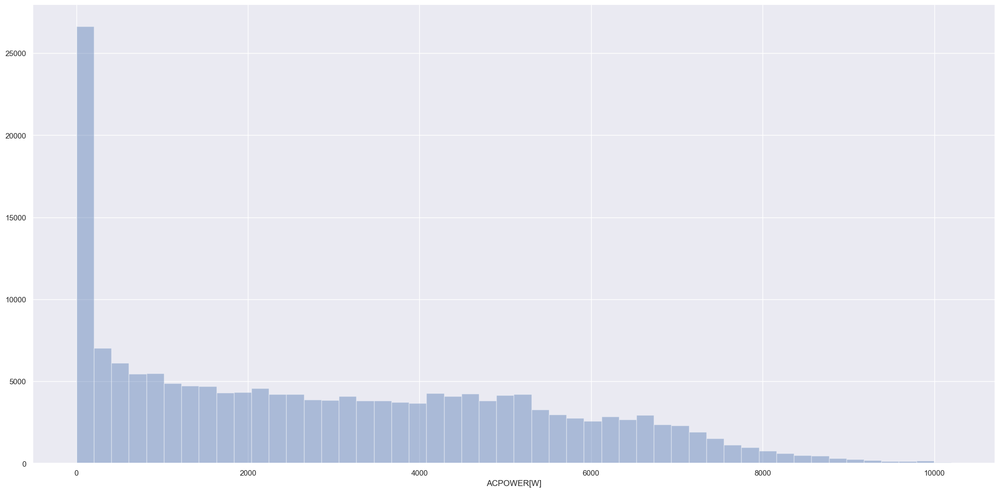

In [162]:
# criando o gráfico de distribuição (histograma) dos dados contidos na coluna 'ACPOWER[W]' do DataFrame df4.
sns.distplot(df4['ACPOWER[W]'], kde=False);

### 4.1.1 VARIÁVEIS NUMÉRICAS

array([[<Axes: title={'center': 'T2M[C]'}>,
        <Axes: title={'center': 'ALLSKY_SW[Wh/m^2]'}>,
        <Axes: title={'center': 'T2MDEW[C]'}>],
       [<Axes: title={'center': 'QV2M[g/kg]'}>,
        <Axes: title={'center': 'RH2M[%]'}>,
        <Axes: title={'center': 'PS[kPa]'}>],
       [<Axes: title={'center': 'WS10M[m/s]'}>,
        <Axes: title={'center': 'WD10M[deg]'}>, <Axes: >]], dtype=object)

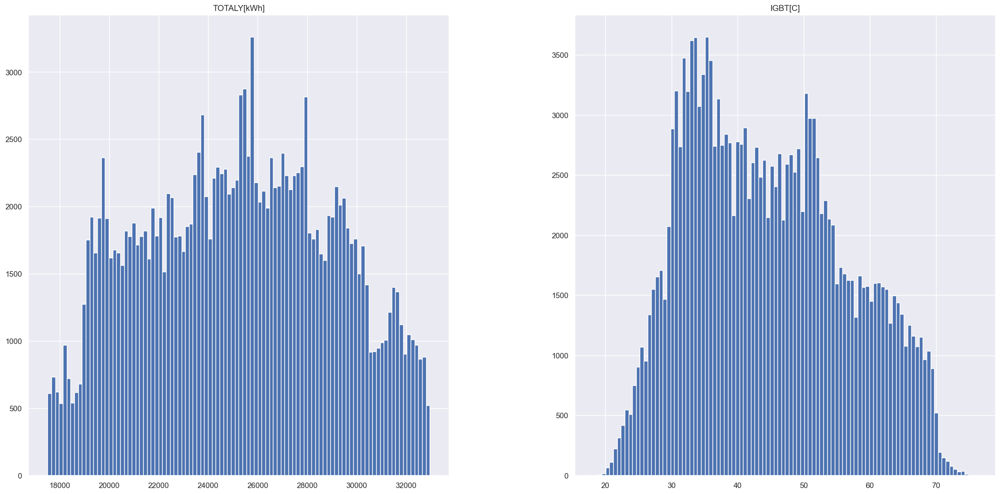

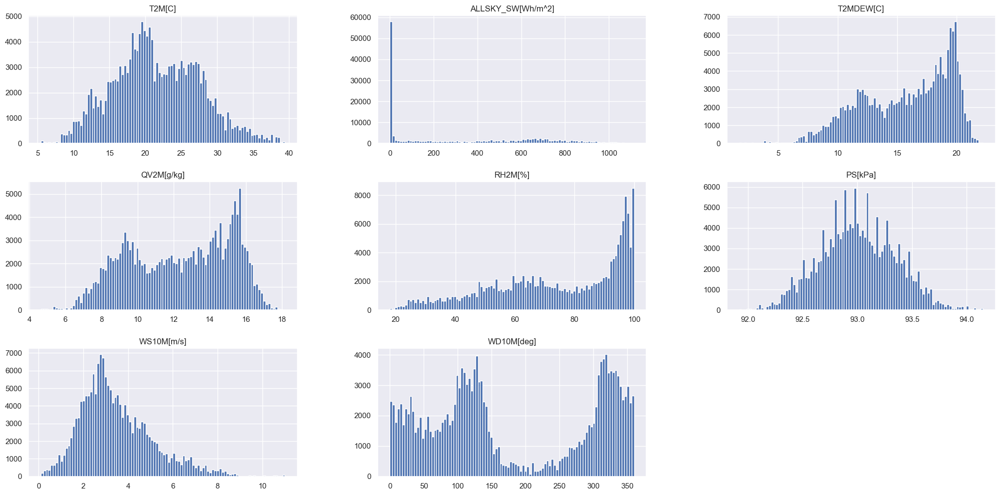

In [163]:
# Seleciona os atributos numéricos do DataFrame df4
num_attributes = df4.select_dtypes(include=['int64', 'float64'])

# Cria histogramas para as colunas 'TOTALY[kWh]' e 'IGBT[C]' com 100 bins (intervalos)
num_attributes[['TOTALY[kWh]', 'IGBT[C]']].hist(bins=100)

# Cria histogramas para as colunas 'T2M[C]', 'ALLSKY_SW[Wh/m^2]', 'T2MDEW[C]', 'QV2M[g/kg]', 'RH2M[%]', 'PS[kPa]', 'WS10M[m/s]', 'WD10M[deg]' com 100 bins (intervalos)
num_attributes[['T2M[C]', 'ALLSKY_SW[Wh/m^2]', 'T2MDEW[C]', 'QV2M[g/kg]', 'RH2M[%]', 'PS[kPa]', 'WS10M[m/s]', 'WD10M[deg]']].hist(bins=100)

### 4.1.1 Geração AC x DC

In [164]:
# Cria uma figura com um layout específico
fig = go.Figure(layout=layout)

# Adiciona um histograma à figura, calculando a média da potência DC ao longo do tempo
fig.add_trace(go.Histogram(histfunc="avg", y=df1["DCPOWER[W]"], x=df4["TIME"], name="Potência DC"))

# Adiciona outro histograma à figura, calculando a média da potência AC ao longo do tempo
fig.add_trace(go.Histogram(histfunc="avg", y=df1["ACPOWER[W]"], x=df4["TIME"], name="Potência AC"))

# Define o modo de sobreposição das barras do histograma
fig.update_layout(barmode='overlay')

# Define a opacidade das barras do histograma para 50%
fig.update_traces(opacity=0.5)

# Atualiza o título do eixo Y para 'Potência média (W)'
fig.update_yaxes(title_text='Potência média (W)')

Perdas média:  96.97013898097423


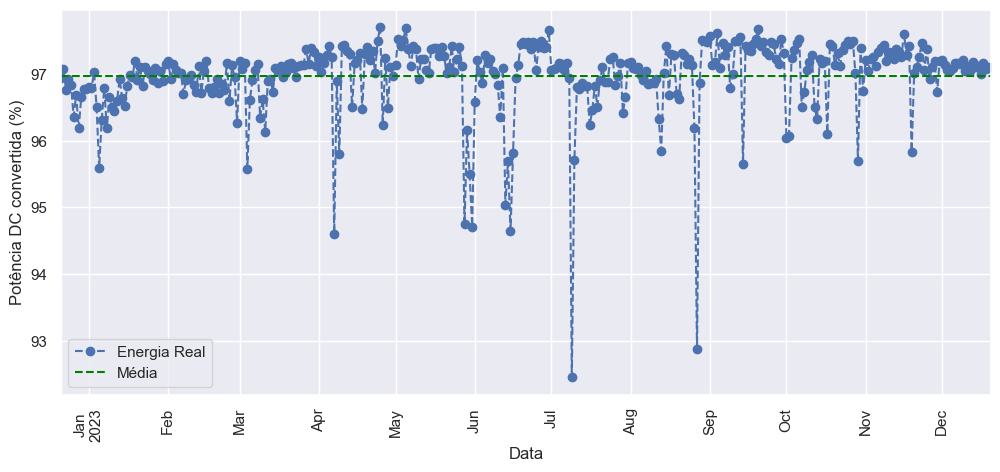

In [165]:
# Perdas na geração de energia
perdas = df4.copy()  # Copia o conteúdo da tabela de dados da planta
perdas = perdas[['ACPOWER[W]', 'DCPOWER[W]', 'DATE']].groupby('DATE').sum()  # Agrupa todos os dados por data e soma os valores de potência AC e DC

# Calcula a porcentagem de perdas na conversão de energia DC para AC
perdas['perdas'] = perdas['ACPOWER[W]'] / perdas['DCPOWER[W]'] * 100

# Plota os dados de energia real convertida
perdas['perdas'].plot(style='o--', figsize=(12, 5), label='Energia Real')

# Imprime a média das perdas
print('Perdas média: ', perdas['perdas'].mean())

# Configurações do gráfico
plt.ylabel('Potência DC convertida (%)', fontsize=12)  # Define o rótulo do eixo Y
plt.xlabel('Data', fontsize=12)  # Define o rótulo do eixo X
plt.axhline(perdas['perdas'].mean(), linestyle='--', color='green', label='Média')  # Plota uma linha horizontal indicando a média das perdas
plt.xticks(rotation=90)  # Rotaciona os rótulos do eixo X para melhor visualização
plt.legend()  # Adiciona a legenda ao gráfico
plt.show()  # Exibe o gráfico

### 4.1.4 Irradiação

In [166]:
# Cria uma figura com um layout específico
fig = go.Figure(layout=layout)

# Cria um histograma utilizando a biblioteca Plotly Express
# O histograma é criado a partir do DataFrame df4
# A coluna 'TIME' é usada para o eixo x (rótulo: "Data")
# A coluna 'ALLSKY_SW[Wh/m^2]' é usada para o eixo y
# A função de agregação utilizada é a média ('avg')
fig = px.histogram(df4, labels={"TIME": "Data"}, x="TIME", y="ALLSKY_SW[Wh/m^2]", histfunc='avg')

# Atualiza o título do eixo y para 'Irradiação média (Wh/m²)'
fig.update_yaxes(title_text='Irradiação média (Wh/m²)')

### 4.1.5 Temperatura

In [167]:
# Cria uma figura com um layout específico
fig = go.Figure(layout=layout)

# Adiciona um histograma à figura, calculando a média da temperatura IGBT ao longo do tempo
fig.add_trace(go.Histogram(histfunc="avg", y=df2['IGBT[C]'], x=df4['TIME'], name="IGBT"))

# Adiciona outro histograma à figura, calculando a média da temperatura ambiente ao longo do tempo
fig.add_trace(go.Histogram(histfunc="avg", y=df2['T2M[C]'], x=df4['TIME'], name="Temp Ambiente"))

# Define o modo de sobreposição das barras do histograma
fig.update_layout(barmode='overlay')

# Define a opacidade das barras do histograma para 50%
fig.update_traces(opacity=0.5)

# Atualiza o título do eixo Y para 'Temperatura média (ºC)'
fig.update_yaxes(title_text='Temperatura média (ºC)')

### 4.1.6 Geração Horária

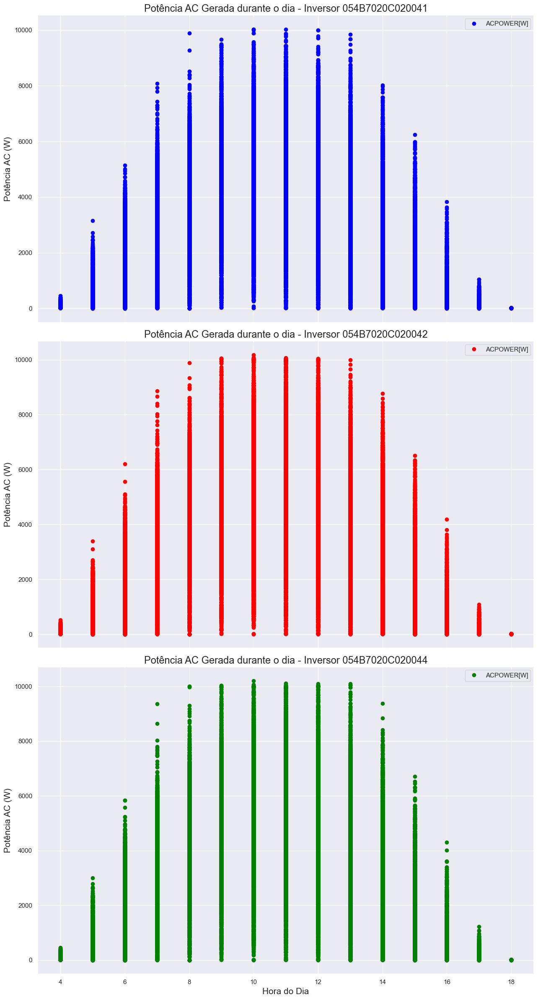

In [168]:
# Copia o DataFrame df4 para a variável inversores
inversores = df4.copy()

# Lista dos identificadores dos inversores
inversores_ids = ['054B7020C020041', '054B7020C020042', '054B7020C020044']

# Lista de cores para os gráficos
cores = ['blue', 'red', 'green']

# Cria uma figura e eixos para os subplots
fig, axes = plt.subplots(nrows=3, ncols=1, figsize=(13, 24), sharex=True)

# Itera sobre os identificadores dos inversores e as cores
for i, (inversor_id, cor) in enumerate(zip(inversores_ids, cores)):
    # Filtra os dados para o inversor atual
    inversor_data = inversores[inversores['INVERTER'] == inversor_id]
    
    # Define a coluna 'HOUR' como índice e plota a potência AC gerada durante o dia
    inversor_data.set_index('HOUR')['ACPOWER[W]'].plot(ax=axes[i], style='o', color=cor, legend=True)
    
    # Define o título do gráfico
    axes[i].set_title(f'Potência AC Gerada durante o dia - Inversor {inversor_id}', size=17)
    
    # Define o rótulo do eixo Y
    axes[i].set_ylabel('Potência AC (W)', fontsize=15)
    
    # Exibe a legenda do gráfico
    axes[i].legend()

# Define o rótulo do eixo X
axes[-1].set_xlabel('Hora do Dia', fontsize=15)

# Ajusta o layout dos subplots para evitar sobreposição
plt.tight_layout()

# Exibe o gráfico
plt.show()

In [169]:
# Removendo intervalo onde a geração de energia é nula

# Cria um filtro para selecionar apenas os registros onde a hora está entre 5h e 16h (excluindo horas fora desse intervalo)
filtro = (df4['TIME'].dt.hour > 4) & (df4['TIME'].dt.hour < 17)

# Aplica o filtro ao DataFrame df4, mantendo apenas os registros que atendem ao critério do filtro
df4 = df4[filtro]

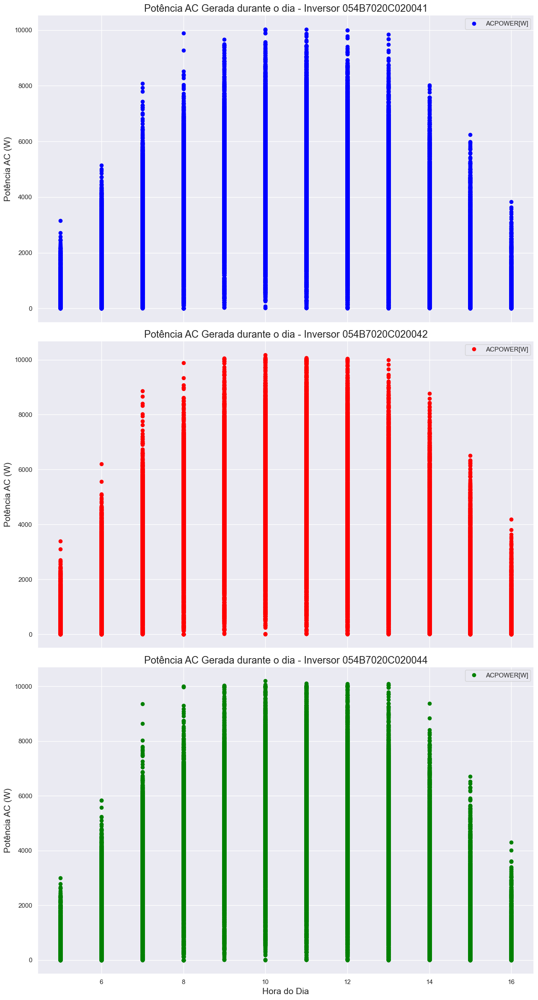

In [170]:
# Cria uma cópia do DataFrame df4 para a variável inversores
inversores = df4.copy()

# Lista dos identificadores dos inversores
inversores_ids = ['054B7020C020041', '054B7020C020042', '054B7020C020044']

# Lista de cores para os gráficos
cores = ['blue', 'red', 'green']

# Cria uma figura e eixos para os subplots
fig, axes = plt.subplots(nrows=3, ncols=1, figsize=(13, 24), sharex=True)

# Itera sobre os identificadores dos inversores e as cores
for i, (inversor_id, cor) in enumerate(zip(inversores_ids, cores)):
    # Filtra os dados para o inversor atual
    inversor_data = inversores[inversores['INVERTER'] == inversor_id]
    
    # Define a coluna 'HOUR' como índice e plota a potência AC gerada durante o dia
    inversor_data.set_index('HOUR')['ACPOWER[W]'].plot(ax=axes[i], style='o', color=cor, legend=True)
    
    # Define o título do gráfico
    axes[i].set_title(f'Potência AC Gerada durante o dia - Inversor {inversor_id}', size=17)
    
    # Define o rótulo do eixo Y
    axes[i].set_ylabel('Potência AC (W)', fontsize=15)
    
    # Exibe a legenda do gráfico
    axes[i].legend()

# Define o rótulo do eixo X
axes[-1].set_xlabel('Hora do Dia', fontsize=15)

# Ajusta o layout dos subplots para evitar sobreposição
plt.tight_layout()

# Exibe o gráfico
plt.show()

### 4.1.7 Verificação de valores nulos de geração

In [171]:
# Reunir os valores nulos de energia
dataframe = df4.copy()  # Cria uma cópia do DataFrame df4
filtro = df4['ACPOWER[W]'] == 0  # Cria um filtro para selecionar as linhas onde a potência AC é igual a 0

geracaoACNula = dataframe[filtro]  # Aplica o filtro ao DataFrame para obter apenas as linhas com potência AC nula

# Histograma com a quantidade de valores nulos
diasNulos = geracaoACNula['HOUR']  # Seleciona a coluna 'HOUR' dos registros com potência AC nula

# Cria um histograma utilizando a biblioteca Plotly Express
# O histograma é criado a partir do DataFrame geracaoACNula
# A coluna 'HOUR' é usada para o eixo x (rótulo: "Data")
# A coluna 'ACPOWER[W]' é usada para o eixo y, contando a quantidade de valores nulos
fig = px.histogram(geracaoACNula, labels={"x": "Data"}, x=diasNulos, y="ACPOWER[W]", histfunc='count')

# Atualiza o título do eixo y para 'Quantidade de valores nulos'
fig.update_yaxes(title_text='Quantidade de valores nulos')

In [172]:
# Histograma com a média de irradiação para quando a geração de energia foi nula
diasNulos = geracaoACNula['HOUR']  # Seleciona a coluna 'HOUR' dos registros com potência AC nula

fig = go.Figure(layout=layout)  # Cria uma figura com um layout específico
# Cria um histograma utilizando a biblioteca Plotly Express
# O histograma é criado a partir do DataFrame geracaoACNula
# A coluna 'HOUR' é usada para o eixo x (rótulo: "Hora")
# A coluna 'ALLSKY_SW[Wh/m^2]' é usada para o eixo y, calculando a média ('avg')
fig = px.histogram(geracaoACNula, labels={'x': "Hora"}, x=diasNulos, y="ALLSKY_SW[Wh/m^2]", histfunc='avg')
# Atualiza o título do eixo y para 'Irradiação solar média para os valores nulos (Wh/m²)'
fig.update_yaxes(title_text='Irradiação solar média para os valores nulos (Wh/m²)')

### 4.1.8 Geração de 7 dias para cada inversor

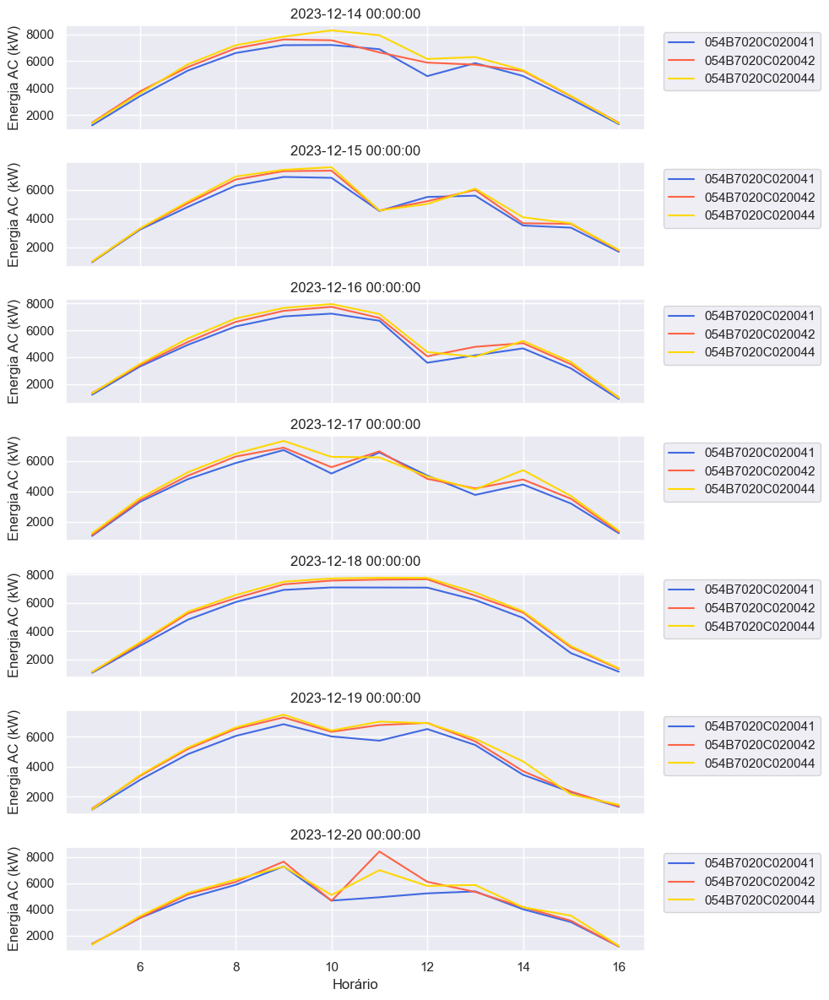

In [173]:
# Cria uma cópia do DataFrame df4
geracao = df4.copy()

# Cria novas colunas 'Horário' e 'Data' a partir das colunas 'HOUR' e 'DATE'
geracao['Horário'] = geracao['HOUR']
geracao['Data'] = geracao['DATE']

# Lista dos identificadores dos inversores
inversores = ['054B7020C020041', '054B7020C020042', '054B7020C020044']

# Lista de cores para os gráficos
cores = ['royalblue', 'tomato', 'gold']

# Filtra os dados do inversor '054B7020C020041' para o período de 14/12/2023 a 20/12/2023
inversores_1 = df4.loc[df4['INVERTER'] == '054B7020C020041'].loc[(df4['DATE'] <= '2023-12-20') & (df4['DATE'] >= '2023-12-14')]

# Cria novas colunas 'Horário' e 'Data' a partir das colunas 'HOUR' e 'DATE'
inversores_1['Horário'] = inversores_1['HOUR']
inversores_1['Data'] = inversores_1['DATE']

# Agrupa os dados por 'Horário' e 'Data', calcula a média da potência AC e reorganiza os dados em uma tabela
cols = inversores_1.groupby(['Horário', 'Data'])['ACPOWER[W]'].mean().unstack()

# Plota os dados do primeiro inversor
ax = inversores_1.groupby(['Horário', 'Data'])['ACPOWER[W]'].mean().unstack().plot(sharex=True, subplots=True, layout=(7, 1), figsize=(10, 12), color=cores[0])

# Itera sobre os outros dois inversores
for j in range(1, 3):
    # Filtra os dados do inversor atual para o período de 14/12/2023 a 20/12/2023
    inversores_2 = df4.loc[df4['INVERTER'] == inversores[j]].loc[(df4['DATE'] <= '2023-12-20') & (df4['DATE'] >= '2023-12-14')]
    
    # Cria novas colunas 'Horário' e 'Data' a partir das colunas 'HOUR' e 'DATE'
    inversores_2['Horário'] = inversores_2['HOUR']
    inversores_2['Data'] = inversores_2['DATE']
    
    # Agrupa os dados por 'Horário' e 'Data', calcula a média da potência AC e plota no mesmo gráfico
    inversores_2.groupby(['Horário', 'Data'])['ACPOWER[W]'].mean().unstack().plot(sharex=True, subplots=True, layout=(7, 1), figsize=(10, 12), color=cores[j], ax=ax)

# Itera sobre os eixos do gráfico para ajustar os títulos e rótulos
i = 0
for linha in range(len(ax)):
    for coluna in range(len(ax[linha])):
        ax[linha, coluna].set_title(cols.columns[i], size=12)  # Define o título do gráfico
        ax[linha, coluna].set_ylabel('Energia AC (kW)')  # Define o rótulo do eixo Y
        ax[linha, coluna].legend(inversores, bbox_to_anchor=(1.02, 1))  # Adiciona a legenda
        i += 1

# Ajusta o layout dos gráficos para evitar sobreposição
plt.tight_layout()

# Exibe os gráficos
plt.show()


### 4.1.9 Outliers

In [174]:
# função que cria um boxplot para cada coluna do DataFrame
def boxplot_individuais(data, colunas, largura = 10, altura = 8):
    # Cria uma nova figura para os gráficos
    fig = plt.figure()
    
    # Ajusta o espaço entre os subplots
    fig.subplots_adjust(hspace = 0.4, wspace = 0.4)
    
    # Define a altura da figura
    fig.set_figheight(altura)
    
    # Define a largura da figura
    fig.set_figwidth(largura)
    
    # Calcula o número de colunas para ajustar os subplots
    ajusteColunas = math.ceil(len(colunas) / 2)
    
    # Itera sobre cada coluna para criar um boxplot
    for i, coluna in enumerate(colunas):
        # Adiciona um subplot à figura
        ax = fig.add_subplot(ajusteColunas, 2, i + 1)
        
        # Cria um boxplot para a coluna atual
        sns.boxplot(x = data[coluna])
        
    # Ajusta o layout dos subplots para evitar sobreposição
    plt.tight_layout()
    
    # Exibe os gráficos
    plt.show()

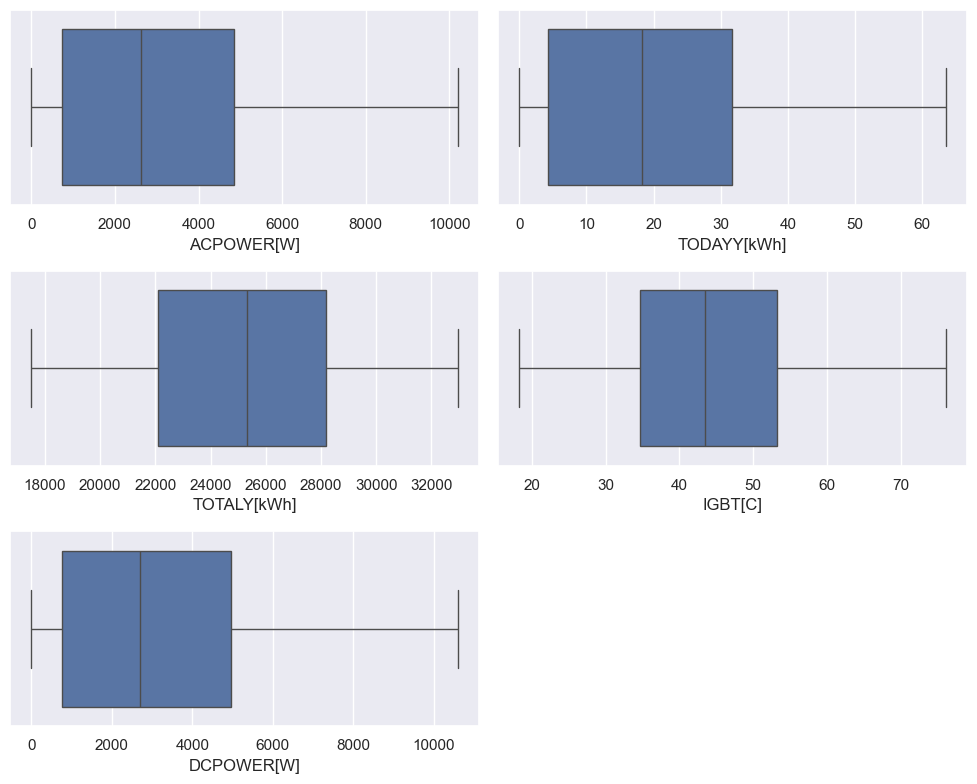

In [175]:
# Retira valores qualitativos da amostra (Data e número de identificação dos inversores)
# Seleciona apenas as colunas quantitativas do DataFrame df4, removendo as colunas qualitativas
quantitativos = df4.drop(['INVERTER', 'TIME', 'DATE', 'YEAR', 'MONTH', 'DAY', 'HOUR', 'MIN', 'DAY_WEEK', 'WEEK_YEAR'], axis=1).columns

# Chama a função boxplot_individuais para criar boxplots das primeiras 5 colunas quantitativas do DataFrame df1
boxplot_individuais(df1, quantitativos[0:5])

## 4.1 Análise Multivariada

### 4.1.1 Correlação

In [176]:
# Filtra o DataFrame df4 para selecionar apenas os dados do inversor '054B7020C020041'
df41 = df4.loc[df4['INVERTER'] == '054B7020C020041']

# Calcula a matriz de correlação, removendo a coluna 'INVERTER'
corr_matrix = df41.drop('INVERTER', axis=1).corr()

# Ordena os valores de correlação com a coluna 'ACPOWER[W]' em ordem decrescente
corr_matrix["ACPOWER[W]"].sort_values(ascending=False)

ACPOWER[W]             1.000000
DCPOWER[W]             0.999887
IGBT[C]                0.857332
ALLSKY_SRF_ALB         0.262216
ALLSKY_KT              0.262189
TODAYY[kWh]            0.114319
RH2M[%]                0.107131
T2MDEW[C]              0.103764
QV2M[g/kg]             0.099214
SZA                    0.063880
PS[kPa]                0.044153
WEEK_YEAR              0.029380
MONTH                  0.023812
TOTALY[kWh]            0.005595
DATE                   0.004625
TIME                   0.004543
T2MWET                 0.003457
DAY_WEEK              -0.010016
MIN                   -0.016497
DAY                   -0.017565
ALLSKY_SW[Wh/m^2]     -0.018471
ALLSKY_SFC_UV_INDEX   -0.021806
YEAR                  -0.030828
UVA[W/m^2]            -0.038576
WS10M[m/s]            -0.045932
CLRSKY_SW[Wh/m^2]     -0.058532
CLRSKY_SFC_PAR_TOT    -0.058771
HOUR                  -0.060053
T2M[C]                -0.060468
WS50M                 -0.098046
UVB[W/m^2]            -0.100177
PREC[mm/

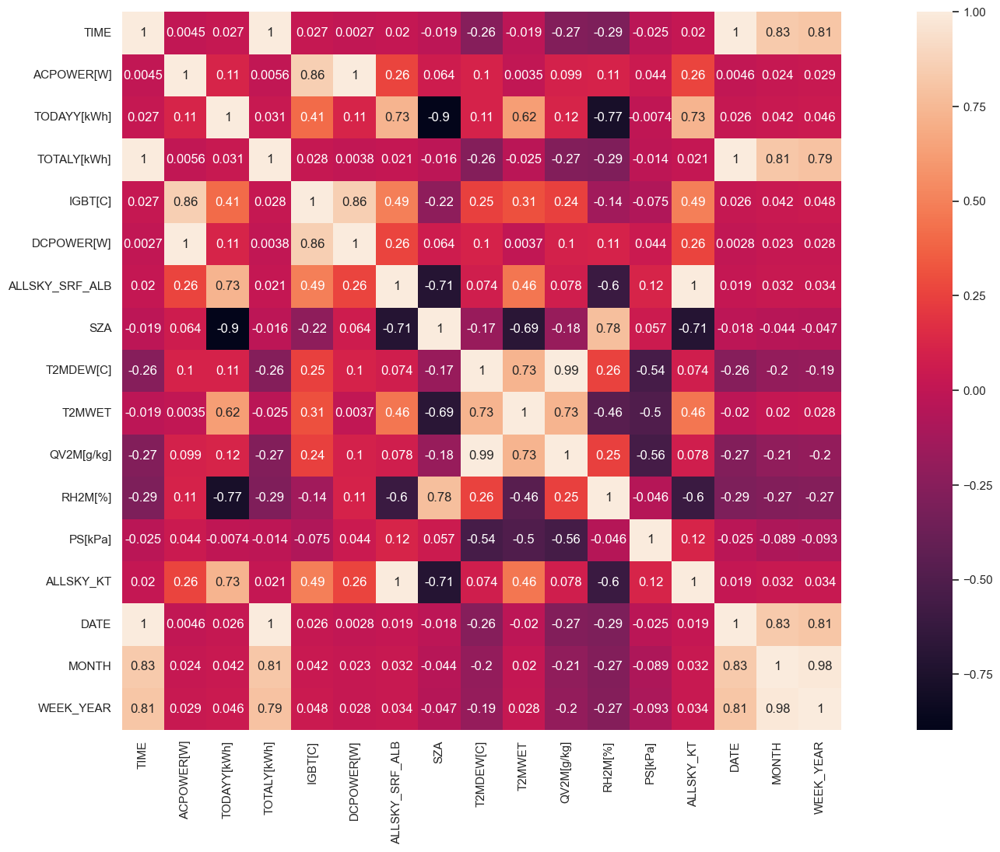

In [177]:
# Cria uma nova figura para o gráfico
fig = plt.figure()

# Cria um mapa de calor (heatmap) da matriz de correlação do DataFrame df41
# Remove as colunas especificadas antes de calcular a correlação
# Usa o método de correlação de Pearson
# Adiciona anotações (valores de correlação) no mapa de calor
# Define o gráfico como quadrado (square=True)
sns.heatmap(df41.drop(['INVERTER', 'DAY_WEEK' , 'MIN', 'DAY', 'ALLSKY_SW[Wh/m^2]', 'ALLSKY_SFC_UV_INDEX', 'YEAR', 'UVA[W/m^2]', 'WS10M[m/s]', 'CLRSKY_SW[Wh/m^2]', 'CLRSKY_SFC_PAR_TOT', 'HOUR', 'T2M[C]', 'WS50M', 'UVB[W/m^2]', 'PREC[mm/hour]', 'WD50M', 'WD10M[deg]'], axis=1).corr(method='pearson'), annot=True, square=True)

# Exibe o gráfico
plt.show()

In [178]:
# calculando e retornando o valor máximo encontrado nessa coluna.
df4['ACPOWER[W]'].max()

10200.0

# 5.0 PREPARAÇÃO DE DADOS

In [179]:
# A partir desse ponto apenas o dataset do inversor 054B7020C020041 será utilizado para treinar o algoritmo

# Cria uma cópia do DataFrame df4 e atribui à variável df5
df5 = df4.copy()

# Cria um filtro para selecionar apenas os dados do inversor 054B7020C020041
filtro41 = (df5['INVERTER'] == '054B7020C020041')

# Cria um filtro para selecionar apenas os dados do inversor 054B7020C020042
filtro42 = (df5['INVERTER'] == '054B7020C020042')

# Cria um filtro para selecionar apenas os dados do inversor 054B7020C020044
filtro44 = (df5['INVERTER'] == '054B7020C020044')

# Exibe as primeiras linhas do DataFrame df5
df5.head()

,TIME,ACPOWER[W],TODAYY[kWh],TOTALY[kWh],IGBT[C],DCPOWER[W],INVERTER,HOUR,ALLSKY_SW[Wh/m^2],ALLSKY_SRF_ALB,...,ALLSKY_SFC_UV_INDEX,CLRSKY_SW[Wh/m^2],ALLSKY_KT,DATE,YEAR,MONTH,WEEK_YEAR,DAY_WEEK,DAY,MIN
27,2022-12-21 05:01:39,400.0,0.1,17510.0,30.0,480.0,054B7020C020041,5,0.0,-999.0,...,0.0,0.0,-999.0,2022-12-21,2022,12,51,3,21,1
28,2022-12-21 05:01:51,460.0,0.1,18990.0,28.9,445.0,054B7020C020044,5,0.0,-999.0,...,0.0,0.0,-999.0,2022-12-21,2022,12,51,3,21,1
29,2022-12-21 05:02:00,460.0,0.1,18899.0,29.6,468.0,054B7020C020042,5,0.0,-999.0,...,0.0,0.0,-999.0,2022-12-21,2022,12,51,3,21,2
30,2022-12-21 05:06:38,550.0,0.2,17510.0,30.4,563.0,054B7020C020041,5,0.0,-999.0,...,0.0,0.0,-999.0,2022-12-21,2022,12,51,3,21,6
31,2022-12-21 05:06:51,560.0,0.1,18990.0,29.4,522.0,054B7020C020044,5,0.0,-999.0,...,0.0,0.0,-999.0,2022-12-21,2022,12,51,3,21,6


## 5.1 SEPARANDO O DATASET EM TREINO E TESTE

In [180]:
# Conjunto de dados de treinamento - inicialmente 80/20
# Seleciona os dados do inversor 054B7020C020041 com data anterior a 14/12/2023
df_train = df5[filtro41][df5[filtro41]['DATE'] < '2023-12-14']

# Conjunto de dados de teste
# Seleciona os dados do inversor 054B7020C020041 com data a partir de 14/12/2023
df_test_41 = df5[filtro41][df5[filtro41]['DATE'] >= '2023-12-14']

# Seleciona os dados do inversor 054B7020C020042 com data a partir de 14/12/2023
df_test_42 = df5[filtro42][df5[filtro42]['DATE'] >= '2023-12-14']

# Seleciona os dados do inversor 054B7020C020044 com data a partir de 14/12/2023
df_test_44 = df5[filtro44][df5[filtro44]['DATE'] >= '2023-12-14']

# Imprime a data mínima e máxima do conjunto de dados de treinamento
print('Data mínima de treinamento: {}'.format(df_train['DATE'].min()))
print('Data máxima de treinamento: {}'.format(df_train['DATE'].max()))

# Imprime a data mínima e máxima do conjunto de dados de teste do inversor 054B7020C020041
print('\nData mínima de teste: {}'.format(df_test_41['DATE'].min()))
print('Data máxima de teste: {}'.format(df_test_41['DATE'].max()))

Data mínima de treinamento: 2022-12-21 00:00:00
Data máxima de treinamento: 2023-12-13 00:00:00

Data mínima de teste: 2023-12-14 00:00:00
Data máxima de teste: 2023-12-20 00:00:00


## 5.1 MÉTODOS Standardization

In [181]:
# Criando uma instância do StandardScaler
ss = pp.StandardScaler()

## 5.1 MÉTODO Rescaling

In [182]:
# normalizando os dados da variável y.
mms_y = pp.MinMaxScaler()

In [183]:
# normalizando as variáveis de entrada e saída do modelo.
def RescalingMMS(df):
    # Normaliza a coluna 'TODAYY[kWh]' usando MinMaxScaler
    df['TODAYY[kWh]'] = mms_y.fit_transform(df[['TODAYY[kWh]']].values)
    
    # Normaliza a coluna 'TOTALY[kWh]' usando MinMaxScaler
    df['TOTALY[kWh]'] = mms_y.fit_transform(df[['TOTALY[kWh]']].values)
    
    # Normaliza a coluna 'IGBT[C]' usando MinMaxScaler
    df['IGBT[C]'] = mms_y.fit_transform(df[['IGBT[C]']].values)
    
    # Normaliza a coluna 'DCPOWER[W]' usando MinMaxScaler
    df['DCPOWER[W]'] = mms_y.fit_transform(df[['DCPOWER[W]']].values)
    
    # Normaliza a coluna 'T2M[C]' usando MinMaxScaler
    df['T2M[C]'] = mms_y.fit_transform(df[['T2M[C]']].values)
    
    # Normaliza a coluna 'CLRSKY_SW[Wh/m^2]' usando MinMaxScaler
    df['CLRSKY_SW[Wh/m^2]'] = mms_y.fit_transform(df[['CLRSKY_SW[Wh/m^2]']].values)
    
    # Normaliza a coluna 'ALLSKY_SW[Wh/m^2]' usando MinMaxScaler
    df['ALLSKY_SW[Wh/m^2]'] = mms_y.fit_transform(df[['ALLSKY_SW[Wh/m^2]']].values)
    
    # Normaliza a coluna 'UVA[W/m^2]' usando MinMaxScaler
    df['UVA[W/m^2]'] = mms_y.fit_transform(df[['UVA[W/m^2]']].values)
    
    # Normaliza a coluna 'UVB[W/m^2]' usando MinMaxScaler
    df['UVB[W/m^2]'] = mms_y.fit_transform(df[['UVB[W/m^2]']].values)
    
    # Normaliza a coluna 'T2MDEW[C]' usando MinMaxScaler
    df['T2MDEW[C]'] = mms_y.fit_transform(df[['T2MDEW[C]']].values)
    
    # Normaliza a coluna 'QV2M[g/kg]' usando MinMaxScaler
    df['QV2M[g/kg]'] = mms_y.fit_transform(df[['QV2M[g/kg]']].values)
    
    # Normaliza a coluna 'RH2M[%]' usando MinMaxScaler
    df['RH2M[%]'] = mms_y.fit_transform(df[['RH2M[%]']].values)
    
    # Normaliza a coluna 'PREC[mm/hour]' usando MinMaxScaler
    df['PREC[mm/hour]'] = mms_y.fit_transform(df[['PREC[mm/hour]']].values)
    
    # Normaliza a coluna 'PS[kPa]' usando MinMaxScaler
    df['PS[kPa]'] = mms_y.fit_transform(df[['PS[kPa]']].values)
    
    # Normaliza a coluna 'WS10M[m/s]' usando MinMaxScaler
    df['WS10M[m/s]'] = mms_y.fit_transform(df[['WS10M[m/s]']].values)
    
    # Normaliza a coluna 'ACPOWER[W]' usando MinMaxScaler
    df['ACPOWER[W]'] = mms_y.fit_transform(df[['ACPOWER[W]']].values)

In [184]:
# Aplicando a normalização MinMaxScaler no conjunto de dados de treinamento
RescalingMMS(df_train)

# Aplicando a normalização MinMaxScaler no conjunto de dados de teste do inversor 054B7020C020041
RescalingMMS(df_test_41)

# Aplicando a normalização MinMaxScaler no conjunto de dados de teste do inversor 054B7020C020042
RescalingMMS(df_test_42)

# Aplicando a normalização MinMaxScaler no conjunto de dados de teste do inversor 054B7020C020044
RescalingMMS(df_test_44)

# Aplicando a normalização MinMaxScaler no conjunto de dados completo
RescalingMMS(df5)

## 5.4 TRANSFORMAÇÃO DE NATUREZA

In [185]:
# criando um novo DataFrame com as colunas 'ACPOWER[W]' e 'TIME' do DataFrame df_train
def time_transform(df):
    # Cria uma nova coluna 'month_sin' aplicando a função seno ao mês
    df['month_sin'] = df['MONTH'].apply(lambda x: np.sin(x * (2 * np.pi/12)))
    # Cria uma nova coluna 'month_cos' aplicando a função cosseno ao mês
    df['month_cos'] = df['MONTH'].apply(lambda x: np.cos(x * (2 * np.pi/12)))

    # Cria uma nova coluna 'week_of_year_sin' aplicando a função seno à semana do ano
    df['week_of_year_sin'] = df['WEEK_YEAR'].apply(lambda x: np.sin(x * (2 * np.pi/52)))
    # Cria uma nova coluna 'week_of_year_cos' aplicando a função cosseno à semana do ano
    df['week_of_year_cos'] = df['WEEK_YEAR'].apply(lambda x: np.cos(x * (2 * np.pi/52)))

    # Cria uma nova coluna 'day_of_week_sin' aplicando a função seno ao dia da semana
    df['day_of_week_sin'] = df['DAY_WEEK'].apply(lambda x: np.sin(x * (2 * np.pi/7)))
    # Cria uma nova coluna 'day_of_week_cos' aplicando a função cosseno ao dia da semana
    df['day_of_week_cos'] = df['DAY_WEEK'].apply(lambda x: np.cos(x * (2 * np.pi/7)))

    # Cria uma nova coluna 'day_sin' aplicando a função seno ao dia do mês
    df['day_sin'] = df['DAY'].apply(lambda x: np.sin(x * (2 * np.pi/30)))
    # Cria uma nova coluna 'day_cos' aplicando a função cosseno ao dia do mês
    df['day_cos'] = df['DAY'].apply(lambda x: np.cos(x * (2 * np.pi/30)))

    # Cria uma nova coluna 'hour_sin' aplicando a função seno à hora
    df['hour_sin'] = df['HOUR'].apply(lambda x: np.sin(x * (2 * np.pi/24)))
    # Cria uma nova coluna 'hour_cos' aplicando a função cosseno à hora
    df['hour_cos'] = df['HOUR'].apply(lambda x: np.cos(x * (2 * np.pi/24)))

    # Cria uma nova coluna 'minute_sin' aplicando a função seno ao minuto
    df['minute_sin'] = df['MIN'].apply(lambda x: np.sin(x * (2 * np.pi/60)))
    # Cria uma nova coluna 'minute_cos' aplicando a função cosseno ao minuto
    df['minute_cos'] = df['MIN'].apply(lambda x: np.cos(x * (2 * np.pi/60)))

    # Define uma lista de colunas que serão eliminadas
    cols_drop = ['MONTH', 'WEEK_YEAR', 'DAY_WEEK', 'DAY', 'HOUR', 'MIN', 'DATE']
    # Elimina as colunas especificadas na lista 'cols_drop'
    df.drop(cols_drop, axis=1, inplace=True)
    
    return None

### 5.4.1 APLICANDO TRANSFORMAÇÃO NO DATASET DE TREINO

In [186]:
# aplicando tarefa específica ao df_train
time_transform(df_train)

### 5.4.1 APLICANDO TRANSFORMAÇÃO NO DATASET DE TESTE

In [187]:
# aplicando tarefa específica ao df_test_41, df_test_42 e df_test_44
time_transform(df_test_41)
time_transform(df_test_42)
time_transform(df_test_44)

### 5.4.1 APLICANDO TRANSFORMAÇÃO NO DATASET COMPLETO

In [188]:
# aplicando tarefa específica ao df5
time_transform(df5)

# 6.0 SELECÇÃO DE VARIÁVEIS

In [189]:
# cpia do dataset tratado para um novo DataFrame
df6 = df5.copy()

## 6.1 SELEÇÃO DE VARIÁVEIS

### 6.1.1 VARIÁVEL RESPOSTA

In [190]:
# Conjunto de dados de treinamento
y_train_41 = df_train[filtro41][['ACPOWER[W]']]  # Seleciona a coluna alvo 'ACPOWER[W]' do conjunto de dados de treinamento

# Conjunto de dados de teste
y_test_41 = df_test_41[['ACPOWER[W]']]  # Seleciona a coluna alvo 'ACPOWER[W]' do conjunto de dados de teste

# Conjunto de dados completo
y_completo_41 = df6[filtro41][['ACPOWER[W]']]  # Seleciona a coluna alvo 'ACPOWER[W]' do conjunto de dados completo

### 6.1.1 APLICANDO O BORUTA COMO SELETOR DE VARIÁVEIS

In [191]:
# Conjunto de dados de treinamento e teste para Boruta
# Elimina variáveis de geração para não enviesar o algoritmo
X_train_n = df_train.drop(['TIME', 'ACPOWER[W]', 'TODAYY[kWh]', 'TOTALY[kWh]', 'IGBT[C]', 'DCPOWER[W]', 'INVERTER'], axis=1).values
# Vetoriza os valores da variável alvo (potência AC) para o conjunto de treinamento
y_train_n = y_train_41.values.ravel()  # ravel é usado para vetorizar os valores

In [192]:
# define randomforestregressor
rf = RandomForestRegressor(n_jobs = -1)

In [193]:
# # Cria uma instância do RandomForestClassifier
# from sklearn.ensemble import RandomForestClassifier
# rf = RandomForestClassifier()

# Cria uma instância do BorutaPy com os parâmetros especificados
# rf: o classificador RandomForest
# n_estimators='auto': define automaticamente o número de estimadores
# verbose=2: define o nível de verbosidade (2 significa que o progresso será mostrado)
# random_state=42: define a semente para geração de números aleatórios para garantir reprodutibilidade
boruta = BorutaPy(rf, n_estimators='auto', verbose=2, random_state=42)

# Ajusta o modelo BorutaPy aos dados de treinamento
# X_train_n: conjunto de dados de entrada para treinamento
# y_train_n: rótulos correspondentes aos dados de treinamento
boruta.fit(X_train_n, y_train_n)

Iteration: 	1 / 100
Confirmed: 	0
Tentative: 	33
Rejected: 	0
Iteration: 	2 / 100
Confirmed: 	0
Tentative: 	33
Rejected: 	0
Iteration: 	3 / 100
Confirmed: 	0
Tentative: 	33
Rejected: 	0
Iteration: 	4 / 100
Confirmed: 	0
Tentative: 	33
Rejected: 	0
Iteration: 	5 / 100
Confirmed: 	0
Tentative: 	33
Rejected: 	0
Iteration: 	6 / 100
Confirmed: 	0
Tentative: 	33
Rejected: 	0
Iteration: 	7 / 100
Confirmed: 	0
Tentative: 	33
Rejected: 	0
Iteration: 	8 / 100
Confirmed: 	22
Tentative: 	2
Rejected: 	9
Iteration: 	9 / 100
Confirmed: 	22
Tentative: 	2
Rejected: 	9
Iteration: 	10 / 100
Confirmed: 	22
Tentative: 	2
Rejected: 	9
Iteration: 	11 / 100
Confirmed: 	22
Tentative: 	2
Rejected: 	9
Iteration: 	12 / 100
Confirmed: 	22
Tentative: 	2
Rejected: 	9
Iteration: 	13 / 100
Confirmed: 	22
Tentative: 	2
Rejected: 	9
Iteration: 	14 / 100
Confirmed: 	22
Tentative: 	2
Rejected: 	9
Iteration: 	15 / 100
Confirmed: 	22
Tentative: 	2
Rejected: 	9
Iteration: 	16 / 100
Confirmed: 	22
Tentative: 	2
Rejected: 	9
I

BorutaPy(estimator=RandomForestRegressor(n_estimators=69, n_jobs=-1,
                                         random_state=RandomState(MT19937) at 0x1ED2BA27440),
         n_estimators='auto',
         random_state=RandomState(MT19937) at 0x1ED2BA27440, verbose=2)

### 6.1.1 MELHORES VARIÁVEIS SELECIONADAS PELO BORUTA

In [194]:
cols_selected = boruta.support_.tolist()

# Seleção das melhores variáveis
# Cria um novo DataFrame X_train_fs removendo as colunas 'TIME', 'ACPOWER[W]', 'TODAYY[kWh]', 'TOTALY[kWh]', 'IGBT[C]', 'DCPOWER[W]' e 'INVERTER' do DataFrame df_train
X_train_fs = df_train.drop(['TIME', 'ACPOWER[W]', 'TODAYY[kWh]', 'TOTALY[kWh]', 'IGBT[C]', 'DCPOWER[W]', 'INVERTER'], axis=1)

In [195]:
# Seleciona as colunas do DataFrame X_train_fs com base nos índices fornecidos em cols_selected
cols_selected_boruta = X_train_fs.iloc[:, cols_selected].columns.to_list()

In [196]:
# colunas de seleção do boruta
cols_selected_boruta

['ALLSKY_SW[Wh/m^2]',
 'SZA',
 'UVA[W/m^2]',
 'T2M[C]',
 'T2MWET',
 'RH2M[%]',
 'PREC[mm/hour]',
 'PS[kPa]',
 'WS10M[m/s]',
 'WD10M[deg]',
 'WS50M',
 'WD50M',
 'ALLSKY_SFC_UV_INDEX',
 'CLRSKY_SW[Wh/m^2]',
 'ALLSKY_KT',
 'week_of_year_sin',
 'week_of_year_cos',
 'day_sin',
 'day_cos',
 'hour_sin',
 'hour_cos',
 'minute_sin',
 'minute_cos']

In [197]:
# Lista das melhores variáveis selecionadas pelo Boruta
cols_selected_boruta = ['T2M[C]',  # Temperatura do ar a 2 metros de altura
                        'T2MDEW[C]',  # Temperatura do ponto de orvalho a 2 metros de altura
                        'T2MWET',  # Temperatura úmida a 2 metros de altura
                        'ALLSKY_SW[Wh/m^2]',  # Irradiação solar total em todas as condições de céu
                        'CLRSKY_SW[Wh/m^2]',  # Irradiação solar em condições de céu claro
                        'ALLSKY_KT',  # Índice de claridade do céu em todas as condições
                        'ALLSKY_SRF_ALB',  # Albedo da superfície em todas as condições de céu
                        'SZA',  # Ângulo zenital solar
                        'UVA[W/m^2]',  # Irradiação ultravioleta A
                        'UVB[W/m^2]',  # Irradiação ultravioleta B
                        'RH2M[%]',  # Umidade relativa do ar a 2 metros de altura
                        'PREC[mm/hour]',  # Precipitação em milímetros por hora
                        'PS[kPa]',  # Pressão atmosférica ao nível da superfície
                        'WS10M[m/s]',  # Velocidade do vento a 10 metros de altura
                        'WS50M',  # Velocidade do vento a 50 metros de altura
                        'week_of_year_cos',  # Componente cossenoidal da semana do ano
                        'day_sin',  # Componente senoidal do dia do mês
                        'day_cos',  # Componente cossenoidal do dia do mês
                        'hour_sin',  # Componente senoidal da hora do dia
                        'minute_sin',  # Componente senoidal do minuto da hora
                        'minute_cos']  # Componente cossenoidal do minuto da hora

# 7.0 APLICANDO MODELOS DE MACHINE LEARNING

In [198]:
# copiando o dataset tratado para um novo DataFrame
df7 = df6.copy()

In [199]:
# Seleciona as colunas do conjunto de treinamento com base nas melhores variáveis selecionadas pelo Boruta
x_train = df_train[cols_selected_boruta]

# Seleciona as colunas do conjunto de teste do inversor 054B7020C020041 com base nas melhores variáveis selecionadas pelo Boruta
x_test_41 = df_test_41[cols_selected_boruta]

# Seleciona as colunas do conjunto de teste do inversor 054B7020C020042 com base nas melhores variáveis selecionadas pelo Boruta
x_test_42 = df_test_42[cols_selected_boruta]

# Seleciona as colunas do conjunto de teste do inversor 054B7020C020044 com base nas melhores variáveis selecionadas pelo Boruta
x_test_44 = df_test_44[cols_selected_boruta]

# Converte os valores da variável alvo (y) do conjunto completo para um array numpy
y_completo_41 = y_completo_41.values  # y quer dizer a variável alvo

## 7.1 Random Forest Regressor

In [200]:
# treinamento (fit)
rf = RandomForestRegressor(n_estimators = 25, n_jobs = -1, random_state = 42).fit(x_train, y_train_41)

In [201]:
# predição (hat)
yhat_rf_41 = pd.DataFrame(rf.predict(x_test_41)) # hat é previsão

### 7.1.1 DADOS NORMALIZADOS

In [202]:
# Avalia a performance do modelo Random Forest Regressor
# A função ml_error calcula métricas de erro entre os valores reais e os valores previstos
rf_result_41 = ml_error('Random forest Regressor', y_test_41, yhat_rf_41)  # passa os valores reais e os previstos

# Exibe o resultado da avaliação
rf_result_41

,Model Name,MAE,RMSE
0,Random forest Regressor,0.180465,0.213506


In [203]:
# Converte os valores reais de teste para um array numpy
y_test_41_rf = y_test_41.values

# Converte os valores previstos pelo modelo Random Forest Regressor para um array numpy
yhat_rf_41 = yhat_rf_41.values

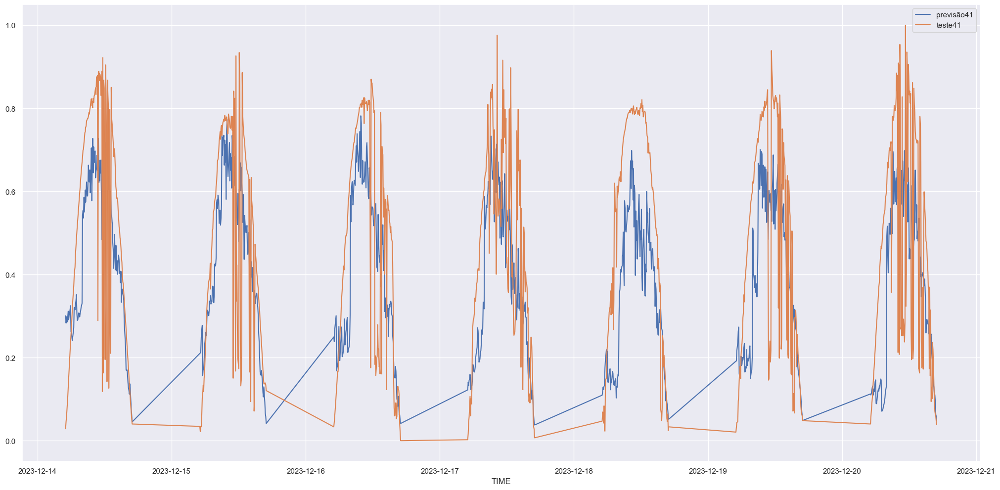

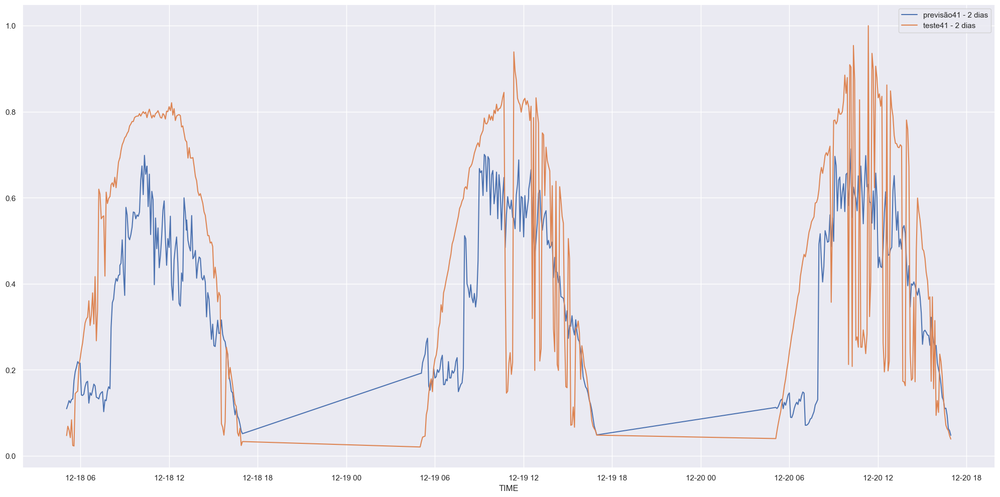

In [204]:
# Cria um gráfico de linha para as previsões do modelo Random Forest Regressor
sns.lineplot(x=df_test_41['TIME'], y=yhat_rf_41[:, 0], label='previsão41')

# Cria um gráfico de linha para os valores reais de teste
sns.lineplot(x=df_test_41['TIME'], y=y_test_41_rf[:, 0], label='teste41')

# Adiciona a coluna 'DATE' ao DataFrame df_test_41
df_test_41['DATE'] = df_test_41['TIME'].dt.date

# Filtra os dados para os últimos 2 dias
df_test_2dias = df_test_41[df_test_41['DATE'] >= (df_test_41['DATE'].max() - pd.Timedelta(days=2))]
yhat_rf_2dias = yhat_rf_41[df_test_41['DATE'] >= (df_test_41['DATE'].max() - pd.Timedelta(days=2))]
y_test_2dias = y_test_41_rf[df_test_41['DATE'] >= (df_test_41['DATE'].max() - pd.Timedelta(days=2))]

# Cria uma nova figura para o gráfico de 2 dias
plt.figure()

# Cria um gráfico de linha para as previsões do modelo Random Forest Regressor para os últimos 2 dias
sns.lineplot(x=df_test_2dias['TIME'], y=yhat_rf_2dias[:, 0], label='previsão41 - 2 dias')

# Cria um gráfico de linha para os valores reais de teste para os últimos 2 dias
sns.lineplot(x=df_test_2dias['TIME'], y=y_test_2dias[:, 0], label='teste41 - 2 dias')

# Exibe os gráficos
plt.show()

### 7.1.1 APLICANDO TANSFORMADA INVERSA PARA VALORES REAIS

In [205]:
# performance
rf_result = ml_error('Random forest Regressor', mms_y.inverse_transform(y_test_41), mms_y.inverse_transform(yhat_rf_41))
rf_result

,Model Name,MAE,RMSE
0,Random forest Regressor,1840.746215,2177.764282


In [206]:
# Converte a série pandas y_train_41 para um array numpy
y_train_41_rf = y_train_41.values

In [207]:
# A coluna ACPOWER vira y (variável resposta)
# Aplica a transformação inversa MinMaxScaler nos dados de teste para obter os valores reais de ACPOWER
y_test_41_rf = mms_y.inverse_transform(y_test_41)

# Aplica a transformação inversa MinMaxScaler nas previsões do modelo para obter os valores reais de ACPOWER previstos
yhat_rf_41 = mms_y.inverse_transform(yhat_rf_41)

# Aplica a transformação inversa MinMaxScaler nos dados completos para obter os valores reais de ACPOWER
y_completo_41_rf = mms_y.inverse_transform(y_completo_41)

# Aplica a transformação inversa MinMaxScaler nos dados de treinamento para obter os valores reais de ACPOWER
y_train_41_rf = mms_y.inverse_transform(y_train_41_rf)

<Axes: xlabel='TIME'>

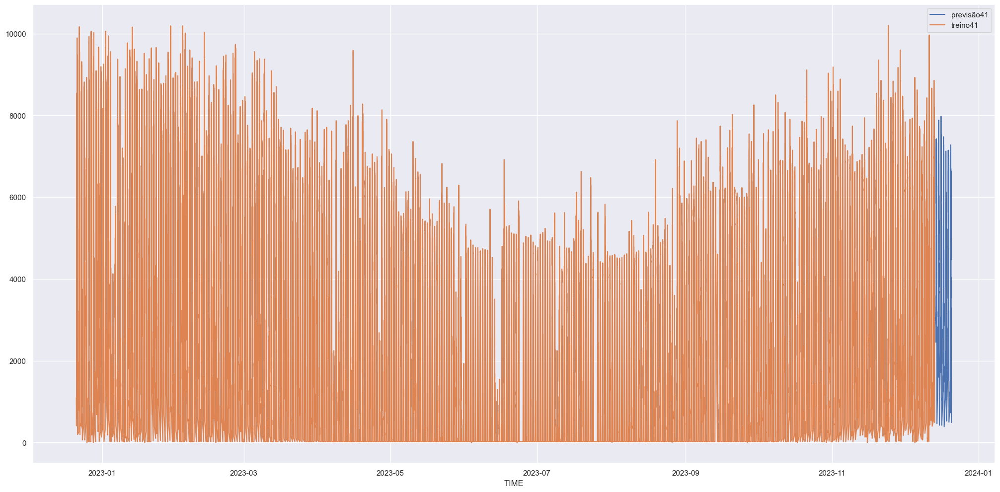

In [208]:
# Cria um gráfico de linha para as previsões do modelo Random Forest Regressor
sns.lineplot(x = df_test_41['TIME'], y = yhat_rf_41[:,0], label = 'previsão41')

# Cria um gráfico de linha para os valores reais de treinamento
sns.lineplot(x = df_train['TIME'], y = y_train_41_rf[:,0], label = 'treino41')

<Axes: xlabel='TIME'>

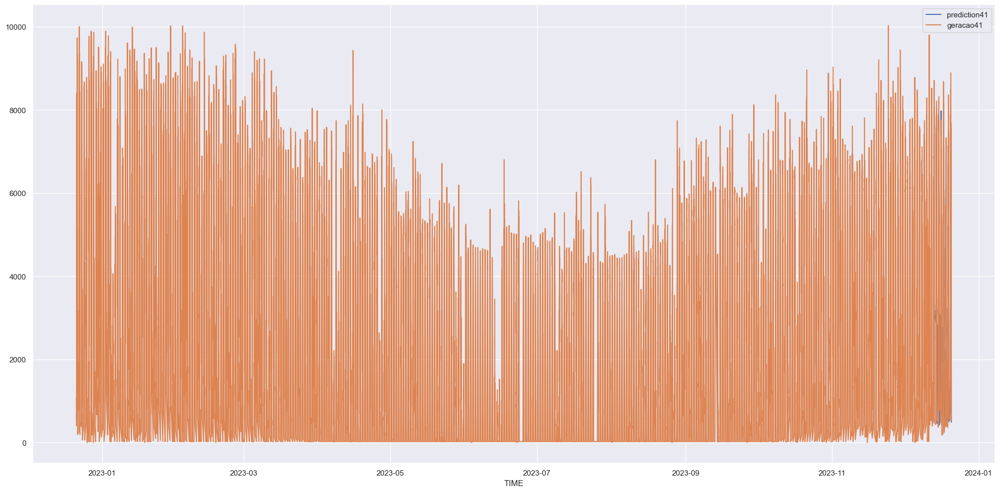

In [209]:
# Cria um gráfico de linha para as previsões do modelo Random Forest Regressor
sns.lineplot(x = df_test_41['TIME'], y = yhat_rf_41[:,0], label = 'prediction41')

# Cria um gráfico de linha para os valores reais de geração de energia do inversor 054B7020C020041
sns.lineplot(x = df7[filtro41]['TIME'], y = y_completo_41_rf[:,0], label = 'geracao41')



## 7.1 MODELO REGRESSÃO LINEAR

In [210]:
# Cria e treina o modelo de Regressão Linear
lr = LinearRegression().fit(x_train, y_train_41)
# lr: variável que armazena o modelo de Regressão Linear
# LinearRegression(): cria uma instância do modelo de Regressão Linear
# .fit(x_train, y_train_41): treina o modelo usando os dados de treino (x_train) e as respostas correspondentes (y_train_41)

In [211]:
# previsão
# Utiliza o modelo de Regressão Linear treinado para fazer previsões com base nos dados de teste (x_test_41)
yhat_lr_41 = pd.DataFrame(lr.predict(x_test_41))

### 7.1.1 DADOS NORMALIZADOS

In [212]:
# Avalia a performance do modelo de Regressão Linear
# A função ml_error calcula métricas de erro entre os valores reais e os valores previstos
lr_result_41 = ml_error('Linear Regression', y_test_41, yhat_lr_41)

# Exibe o resultado da avaliação
lr_result_41

,Model Name,MAE,RMSE
0,Linear Regression,3.39012,3.647667


In [213]:
# Converte a série pandas y_test_41 para um array numpy
y_test_41_lr = y_test_41.values

# Converte a série pandas yhat_lr_41 para um array numpy
yhat_lr_41 = yhat_lr_41.values

<Axes: xlabel='TIME', ylabel='PREDICTION'>

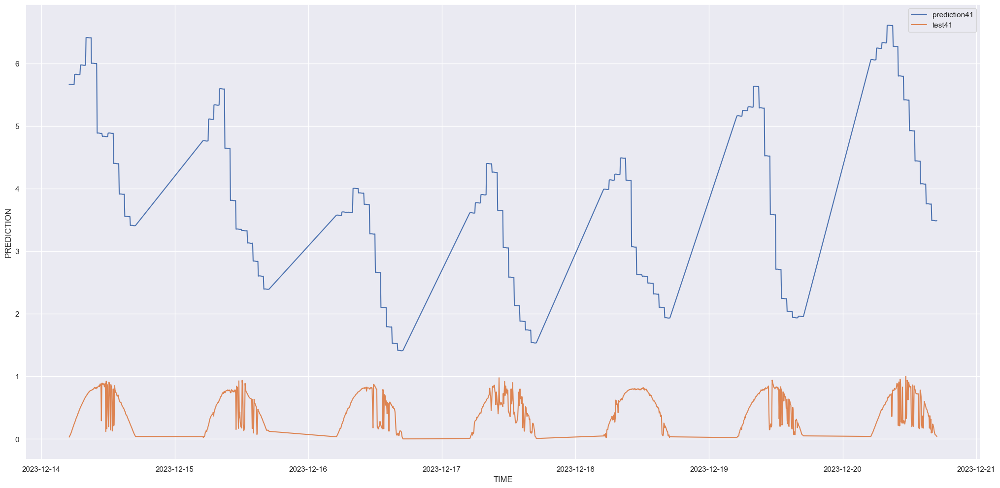

In [214]:
# Cria um DataFrame para as previsões do modelo de Regressão Linear com a coluna TIME
df_pred_lr = pd.DataFrame({'TIME': df_test_41['TIME'], 'PREDICTION': yhat_lr_41[:, 0]})

# Cria um DataFrame para os valores reais de teste com a coluna TIME
df_test_lr = pd.DataFrame({'TIME': df_test_41['TIME'], 'TEST': y_test_41_lr[:, 0]})

# Ordena os DataFrames pelo tempo para garantir o alinhamento
df_pred_lr = df_pred_lr.sort_values(by='TIME').reset_index(drop=True)
df_test_lr = df_test_lr.sort_values(by='TIME').reset_index(drop=True)

# Cria um gráfico de linha para as previsões do modelo de Regressão Linear
sns.lineplot(x='TIME', y='PREDICTION', data=df_pred_lr, label='prediction41')  # Plota a previsão do modelo de Regressão Linear ao longo do tempo

# Cria um gráfico de linha para os valores reais de teste
sns.lineplot(x='TIME', y='TEST', data=df_test_lr, label='test41')  # Plota os valores reais de teste ao longo do tempo

### 7.1.1 APLICANDO TANSFORMADA INVERSA PARA VALORES REAIS

In [215]:
# Avalia a performance do modelo de Regressão Linear
# A função ml_error calcula métricas de erro entre os valores reais e os valores previstos
# Aplica a transformação inversa MinMaxScaler nos dados de teste para obter os valores reais de ACPOWER
# Aplica a transformação inversa MinMaxScaler nas previsões do modelo para obter os valores reais de ACPOWER previstos
lr_result = ml_error('Linear Regression', mms_y.inverse_transform(y_test_41), mms_y.inverse_transform(yhat_lr_41))

# Exibe o resultado da avaliação
lr_result

,Model Name,MAE,RMSE
0,Linear Regression,34579.222823,37206.203328


In [216]:
# Converte a série pandas 'y_train_41' para um array numpy
y_train_41_lr = y_train_41.values

In [217]:
# Aplica a transformação inversa MinMaxScaler nos dados de teste para obter os valores reais de ACPOWER
y_test_41_lr = mms_y.inverse_transform(y_test_41)

# Aplica a transformação inversa MinMaxScaler nas previsões do modelo para obter os valores reais de ACPOWER previstos
yhat_lr_41 = mms_y.inverse_transform(yhat_lr_41)

# Aplica a transformação inversa MinMaxScaler nos dados completos para obter os valores reais de ACPOWER
y_completo_41_lr = mms_y.inverse_transform(y_completo_41)

# Aplica a transformação inversa MinMaxScaler nos dados de treinamento para obter os valores reais de ACPOWER
y_train_41_lr = mms_y.inverse_transform(y_train_41_lr)

<Axes: xlabel='TIME'>

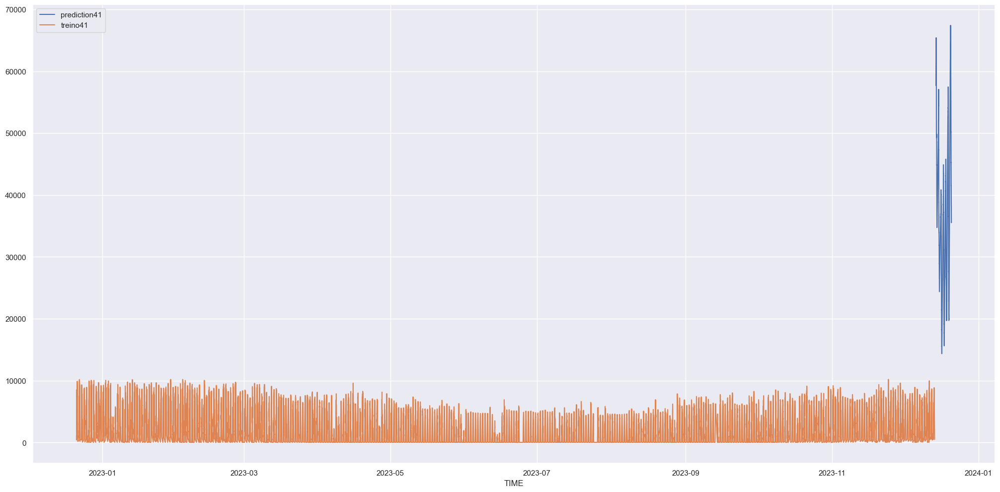

In [218]:
# Cria um gráfico de linha para as previsões do modelo de Regressão Linear
sns.lineplot(x = df_test_41['TIME'], y = yhat_lr_41[:,0], label = 'prediction41')  # Plota a previsão do modelo de Regressão Linear ao longo do tempo

# Cria um gráfico de linha para os valores reais de treinamento
sns.lineplot(x = df_train['TIME'], y = y_train_41_lr[:,0], label = 'treino41')  # Plota os valores reais de treinamento ao longo do tempo

<Axes: xlabel='TIME'>

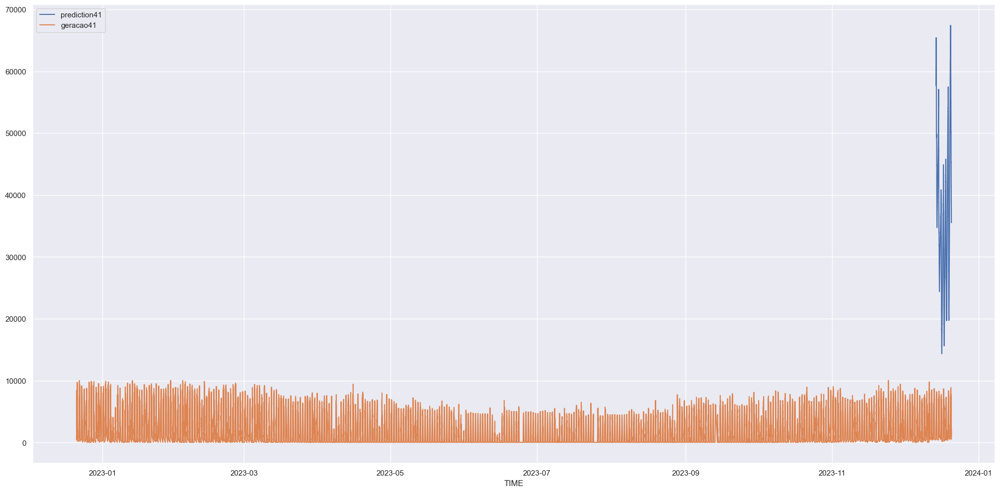

In [219]:
# Cria um gráfico de linha para as previsões do modelo de Regressão Linear
sns.lineplot(x = df_test_41['TIME'], y = yhat_lr_41[:,0], label = 'prediction41')  # Plota a previsão do modelo de Regressão Linear ao longo do tempo

# Cria um gráfico de linha para os valores reais de geração de energia do inversor 054B7020C020041
sns.lineplot(x = df7[filtro41]['TIME'], y = y_completo_41_lr[:,0], label = 'geracao41')  # Plota os valores reais de geração de energia ao longo do tempo

## 7.1 Decision Tree Regressor

In [220]:
# Cria e treina o modelo de Regressão com Árvore de Decisão
dt = DecisionTreeRegressor().fit(x_train, y_train_41)

# dt: variável que armazena o modelo de Regressão com Árvore de Decisão
# DecisionTreeRegressor(): cria uma instância do modelo de Regressão com Árvore de Decisão
# .fit(x_train, y_train_41): treina o modelo usando os dados de treino (x_train) e as respostas correspondentes (y_train_41)

In [221]:
# previsão
# Utiliza o modelo de Regressão com Árvore de Decisão treinado para fazer previsões com base nos dados de teste (x_test_41)
yhat_dt_41 = pd.DataFrame(dt.predict(x_test_41))

### 7.1.1 DADOS NORMALIZADOS

In [222]:
# Avalia a performance do modelo de Regressão com Árvore de Decisão
# A função ml_error calcula métricas de erro entre os valores reais e os valores previstos
dt_result_41 = ml_error('Decision Tree Regressor', y_test_41, yhat_dt_41)

# Exibe o resultado da avaliação
dt_result_41

,Model Name,MAE,RMSE
0,Decision Tree Regressor,0.196637,0.264838


In [223]:
# Converte a série pandas y_test_41 para um array numpy
y_test_41_dt = y_test_41.values  # y_test_41 contém os valores reais de teste

# Converte a série pandas yhat_dt_41 para um array numpy
yhat_dt_41 = yhat_dt_41  # yhat_dt_41 já é um array numpy contendo as previsões do modelo de Árvore de Decisão

<Axes: xlabel='TIME'>

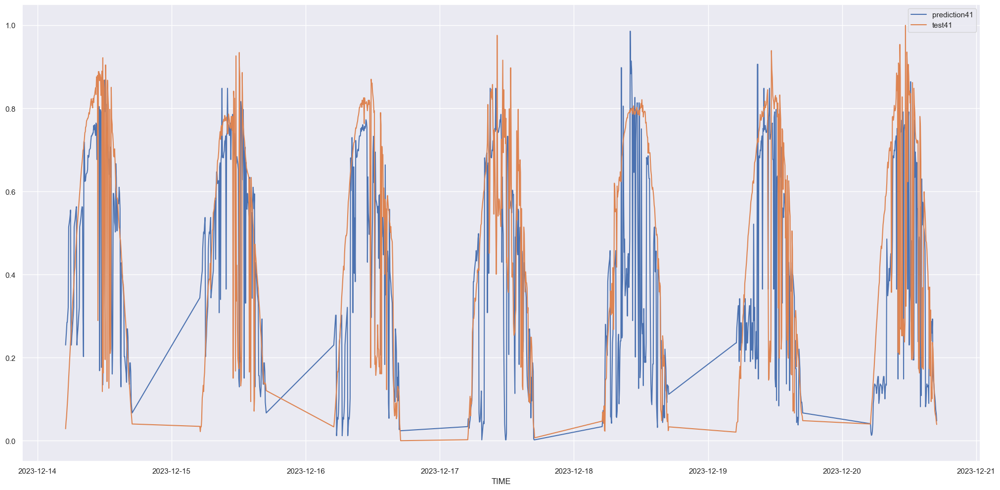

In [224]:
# Cria um gráfico de linha para as previsões do modelo de Árvore de Decisão
sns.lineplot(x = df_test_41['TIME'], y = yhat_dt_41.values[:, 0], label = 'prediction41')  # Plota a previsão do modelo de Árvore de Decisão ao longo do tempo

# Cria um gráfico de linha para os valores reais de teste
sns.lineplot(x = df_test_41['TIME'], y = y_test_41_dt[:, 0], label = 'test41')  # Plota os valores reais de teste ao longo do tempo

### 7.1.1 APLICANDO TANSFORMADA INVERSA PARA VALORES REAIS

In [225]:
# Avalia a performance do modelo de Regressão com Árvore de Decisão
# A função ml_error calcula métricas de erro entre os valores reais e os valores previstos
# Aplica a transformação inversa MinMaxScaler nos dados de teste para obter os valores reais de ACPOWER
# Aplica a transformação inversa MinMaxScaler nas previsões do modelo para obter os valores reais de ACPOWER previstos
dt_result = ml_error('Decision Tree Regressor', mms_y.inverse_transform(y_test_41), mms_y.inverse_transform(yhat_dt_41))

# Exibe o resultado da avaliação
dt_result

,Model Name,MAE,RMSE
0,Decision Tree Regressor,2005.69669,2701.351221


In [226]:
# Converte a série y_train_41 para um array numpy
y_train_41_dt = y_train_41.values

In [227]:
# Aplica a transformação inversa MinMaxScaler nos dados de teste para obter os valores reais de ACPOWER
y_test_41_dt = mms_y.inverse_transform(y_test_41)

# Aplica a transformação inversa MinMaxScaler nas previsões do modelo para obter os valores reais de ACPOWER previstos
yhat_dt_41 = mms_y.inverse_transform(yhat_dt_41)

# Aplica a transformação inversa MinMaxScaler nos dados completos para obter os valores reais de ACPOWER
y_completo_41_dt = mms_y.inverse_transform(y_completo_41)

# Aplica a transformação inversa MinMaxScaler nos dados de treinamento para obter os valores reais de ACPOWER
y_train_41_dt = mms_y.inverse_transform(y_train_41_dt)

<Axes: xlabel='TIME'>

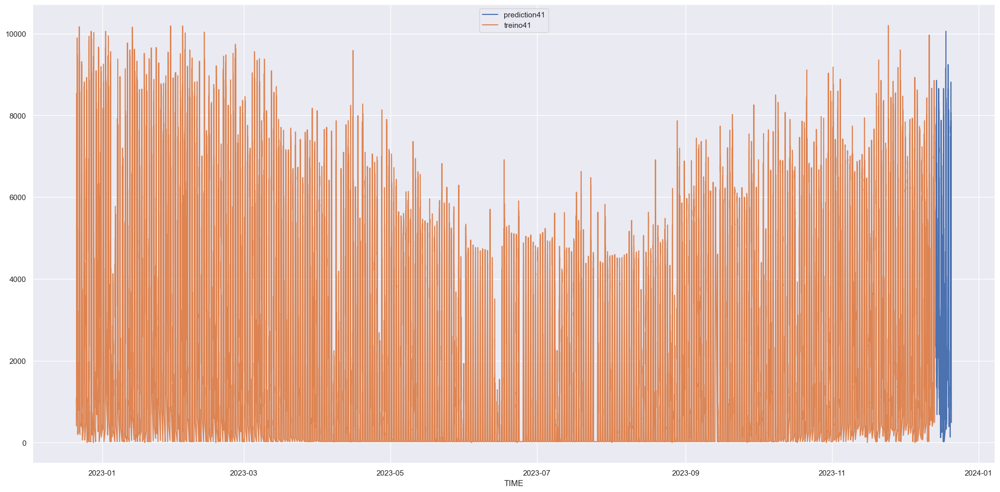

In [228]:
# Cria um gráfico de linha para as previsões do modelo de Árvore de Decisão
sns.lineplot(x = df_test_41['TIME'], y = yhat_dt_41[:,0], label = 'prediction41')  # Plota a previsão do modelo de Árvore de Decisão ao longo do tempo

# Cria um gráfico de linha para os valores reais de treinamento
sns.lineplot(x = df_train['TIME'], y = y_train_41_dt[:,0], label = 'treino41')  # Plota os valores reais de treinamento ao longo do tempo

<Axes: xlabel='TIME'>

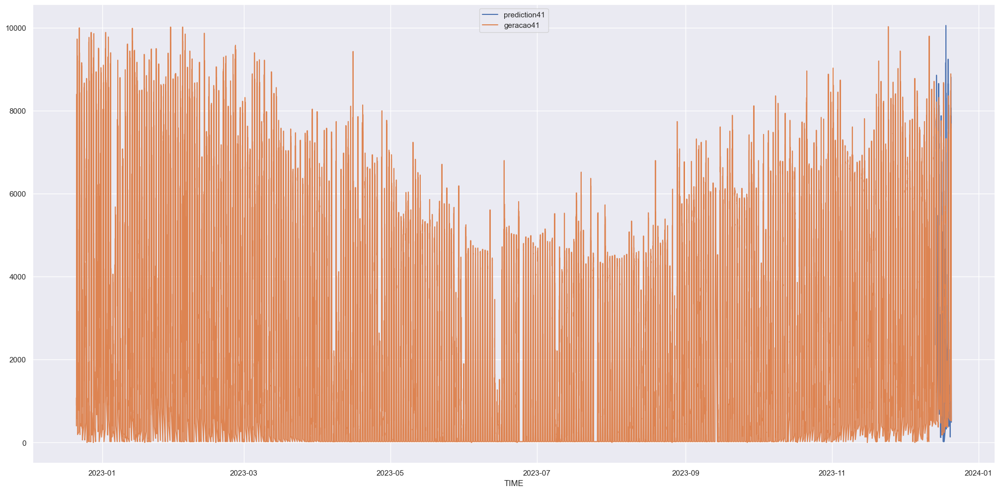

In [229]:
# Cria um gráfico de linha para as previsões do modelo de Árvore de Decisão
sns.lineplot(x = df_test_41['TIME'], y = yhat_dt_41[:,0], label = 'prediction41')  # Plota a previsão do modelo de Árvore de Decisão ao longo do tempo

# Cria um gráfico de linha para os valores reais de geração de energia do inversor 054B7020C020041
sns.lineplot(x = df7[filtro41]['TIME'], y = y_completo_41_dt[:,0], label = 'geracao41')  # Plota os valores reais de geração de energia ao longo do tempo

# Geração Total (SOMATÓRIO DA GERAÇÃO DOS TRÊS INVERSORES)

In [230]:
# Seleciona as colunas do conjunto de teste do inversor 054B7020C020041 com base nas melhores variáveis selecionadas pelo Boruta
x_test_41 = df_test_41[cols_selected_boruta]

# Seleciona as colunas do conjunto de teste do inversor 054B7020C020042 com base nas melhores variáveis selecionadas pelo Boruta
x_test_42 = df_test_42[cols_selected_boruta]

# Seleciona as colunas do conjunto de teste do inversor 054B7020C020044 com base nas melhores variáveis selecionadas pelo Boruta
x_test_44 = df_test_44[cols_selected_boruta]

In [231]:
# Previsão para o inversor 054B7020C020041 usando o modelo de Árvore de Decisão
yhat_dt_41 = pd.DataFrame(dt.predict(x_test_41))  # dt -> modelo de Árvore de Decisão, x_test_41 -> dados de teste do inversor 054B7020C020041

# Previsão para o inversor 054B7020C020042 usando o modelo de Árvore de Decisão
yhat_dt_42 = pd.DataFrame(dt.predict(x_test_42))  # dt -> modelo de Árvore de Decisão, x_test_42 -> dados de teste do inversor 054B7020C020042

# Previsão para o inversor 054B7020C020044 usando o modelo de Árvore de Decisão
yhat_dt_44 = pd.DataFrame(dt.predict(x_test_44))  # dt -> modelo de Árvore de Decisão, x_test_44 -> dados de teste do inversor 054B7020C020044

In [232]:
# Converte a série pandas yhat_dt_41 para um array numpy
yhat_dt_41 = yhat_dt_41.values  # yhat_dt_41 contém as previsões do modelo de Árvore de Decisão para o inversor 054B7020C020041

# Converte a série pandas yhat_dt_42 para um array numpy
yhat_dt_42 = yhat_dt_42.values  # yhat_dt_42 contém as previsões do modelo de Árvore de Decisão para o inversor 054B7020C020042

# Converte a série pandas yhat_dt_44 para um array numpy
yhat_dt_44 = yhat_dt_44.values  # yhat_dt_44 contém as previsões do modelo de Árvore de Decisão para o inversor 054B7020C020044

In [233]:
# Aplica a transformação inversa MinMaxScaler nas previsões do modelo para o inversor 054B7020C020041
yhat_dt_41 = mms_y.inverse_transform(yhat_dt_41)

# Aplica a transformação inversa MinMaxScaler nas previsões do modelo para o inversor 054B7020C020042
yhat_dt_42 = mms_y.inverse_transform(yhat_dt_42)

# Aplica a transformação inversa MinMaxScaler nas previsões do modelo para o inversor 054B7020C020044
yhat_dt_44 = mms_y.inverse_transform(yhat_dt_44)

In [234]:
# Adiciona a previsão de potência AC (yhat_dt_41) ao DataFrame df_test_41 na coluna 'ACPOWERHAT[W]'
df_test_41['ACPOWERHAT[W]'] = yhat_dt_41

# Adiciona a previsão de potência AC (yhat_dt_42) ao DataFrame df_test_42 na coluna 'ACPOWERHAT[W]'
df_test_42['ACPOWERHAT[W]'] = yhat_dt_42

# Adiciona a previsão de potência AC (yhat_dt_44) ao DataFrame df_test_44 na coluna 'ACPOWERHAT[W]'
df_test_44['ACPOWERHAT[W]'] = yhat_dt_44

# Concatena os DataFrames df_test_41, df_test_42 e df_test_44 em um único DataFrame, ignorando os índices originais
df_test_hat = pd.concat([df_test_41, df_test_42, df_test_44], ignore_index=True)

In [258]:
# Converte a coluna 'TIME' para o formato de data e armazena na coluna 'DATE'
df5['DATE'] = pd.to_datetime(df5['TIME'].dt.date, dayfirst=True)

# Filtra os dados para datas anteriores a 14/12/2023, agrupa por 'DATE' e soma a geração diária de potência AC dos três inversores
df_total_train = df5[df5['DATE'] < '2023-12-14'].groupby('DATE')['ACPOWER[W]'].sum().reset_index()

# Filtra os dados para datas a partir de 14/12/2023, agrupa por 'DATE' e soma a geração diária de potência AC dos três inversores
df_total_test = df5[df5['DATE'] >= '2023-12-14'].groupby('DATE')['ACPOWER[W]'].sum().reset_index()

# Agrupa os dados previstos por data e soma a geração diária de potência AC prevista dos três inversores
df_total_hat = df_test_hat.groupby(df_test_hat['TIME'].dt.date)['ACPOWERHAT[W]'].sum().reset_index()


# bloco 2 - gráfico separado para o período de 01/12/2023 a 21/12/2023

# Filtra os dados para o período de 01/12/2023 a 21/12/2023 no conjunto de teste
df_total_test_period = df_total_test[(df_total_test['DATE'] >= '2023-12-01') & (df_total_test['DATE'] <= '2023-12-21')]

# Filtra os dados de treino para o mesmo período
df_total_train_period = df_total_train[(df_total_train['DATE'] >= '2023-12-01') & (df_total_train['DATE'] <= '2023-12-21')]

# Converte a coluna 'TIME' para o formato de data
df_total_hat['DATE'] = pd.to_datetime(df_total_hat['TIME']).dt.date

# Filtra os dados previstos para o mesmo período
df_total_hat_period = df_total_hat[(df_total_hat['DATE'] >= pd.to_datetime('2023-12-01').date()) & (df_total_hat['DATE'] <= pd.to_datetime('2023-12-21').date())]


In [259]:
# Exibe as primeiras 5 linhas do DataFrame 'df' para uma visualização rápida dos dados
df.head()

,TIME,ACPOWER[W],TODAYY[kWh],TOTALY[kWh],IGBT[C],DCPOWER[W],INVERTER,HOUR,ALLSKY_SW[Wh/m^2],ALLSKY_SRF_ALB,...,RH2M[%],PREC[mm/hour],PS[kPa],WS10M[m/s],WD10M[deg],WS50M,WD50M,ALLSKY_SFC_UV_INDEX,CLRSKY_SW[Wh/m^2],ALLSKY_KT
0,2022-12-21 04:16:16,20.0,0.0,18898.0,25.2,39,054B7020C020042,4,0.0,-999.0,...,95.33,0.51,92.49,4.03,153.5,6.32,152.8,0.0,0.0,-999.0
1,2022-12-21 04:16:19,20.0,0.0,18990.0,24.5,30,054B7020C020044,4,0.0,-999.0,...,95.33,0.51,92.49,4.03,153.5,6.32,152.8,0.0,0.0,-999.0
2,2022-12-21 04:16:34,20.0,0.0,17510.0,25.6,30,054B7020C020041,4,0.0,-999.0,...,95.33,0.51,92.49,4.03,153.5,6.32,152.8,0.0,0.0,-999.0
3,2022-12-21 04:21:18,20.0,0.0,18898.0,25.5,84,054B7020C020042,4,0.0,-999.0,...,95.33,0.51,92.49,4.03,153.5,6.32,152.8,0.0,0.0,-999.0
4,2022-12-21 04:21:19,20.0,0.0,18990.0,25.0,85,054B7020C020044,4,0.0,-999.0,...,95.33,0.51,92.49,4.03,153.5,6.32,152.8,0.0,0.0,-999.0


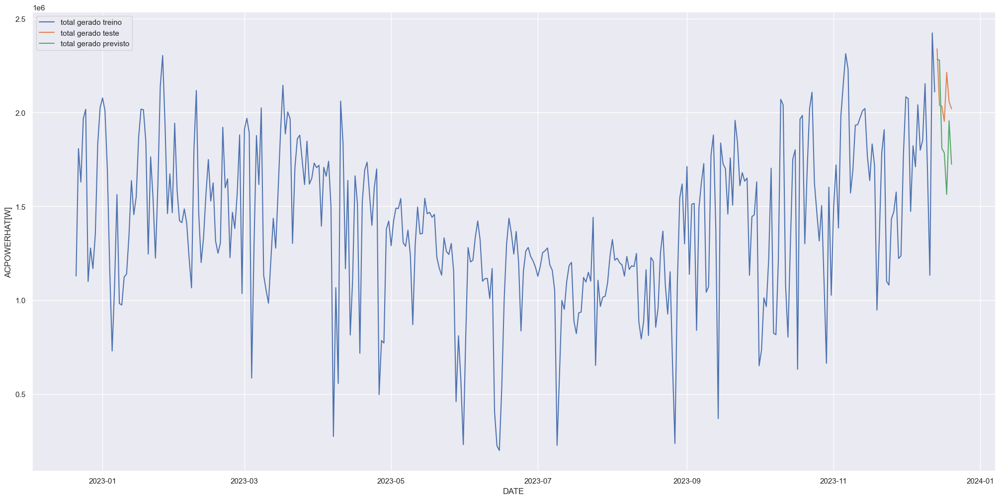

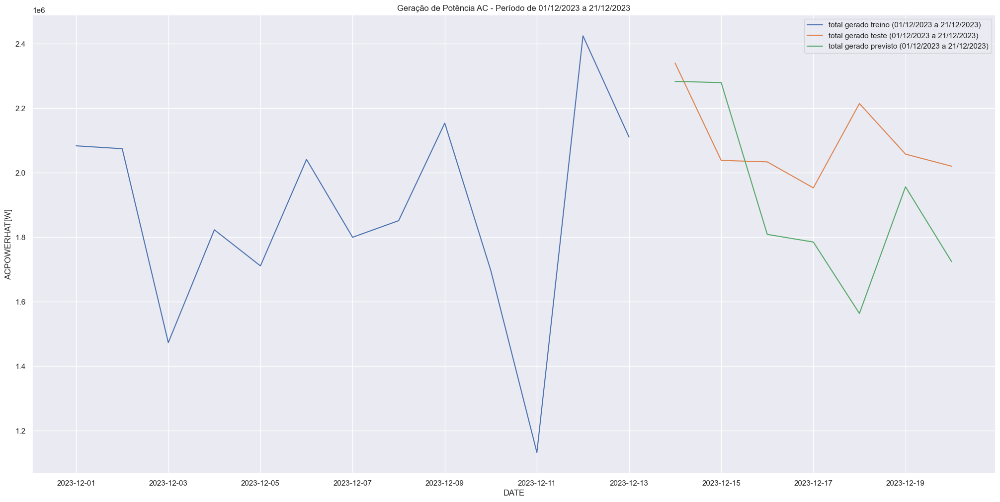

In [260]:
# Plota a linha do total gerado no conjunto de treino
sns.lineplot(x = df_total_train['DATE'], y = mms_y.inverse_transform(df_total_train[['ACPOWER[W]']].values)[:,0], label = 'total gerado treino')

# Plota a linha do total gerado no conjunto de teste
sns.lineplot(x = df_total_test['DATE'], y = mms_y.inverse_transform(df_total_test[['ACPOWER[W]']].values)[:,0], label = 'total gerado teste')

# Plota a linha do total gerado previsto
sns.lineplot(x = df_total_hat['TIME'], y = df_total_hat['ACPOWERHAT[W]'], label = 'total gerado previsto')




# Cria 2º figura
plt.figure()

# Plota a linha do total gerado no conjunto de treino para o período especificado
sns.lineplot(x = df_total_train_period['DATE'], y = mms_y.inverse_transform(df_total_train_period[['ACPOWER[W]']].values)[:,0], label = 'total gerado treino (01/12/2023 a 21/12/2023)')

# Plota a linha do total gerado no conjunto de teste para o período especificado
sns.lineplot(x = df_total_test_period['DATE'], y = mms_y.inverse_transform(df_total_test_period[['ACPOWER[W]']].values)[:,0], label = 'total gerado teste (01/12/2023 a 21/12/2023)')

# Plota a linha do total gerado previsto para o período especificado
sns.lineplot(x = df_total_hat_period['DATE'], y = df_total_hat_period['ACPOWERHAT[W]'], label = 'total gerado previsto (01/12/2023 a 21/12/2023)')

# Adiciona um título ao gráfico
plt.title('Geração de Potência AC - Período de 01/12/2023 a 21/12/2023')

# Exibe o segundo gráfico
plt.show()

